In [6]:
%load_ext autoreload
%autoreload 2
%config InlineBackend.figure_format = 'retina'

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [42]:
import sys
sys.path.append("..")
if not sys.warnoptions:
    import warnings
    warnings.simplefilter("ignore")

from typing import Optional, Union
from copy import deepcopy
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import norm

from coordination.model.real.fnirs import FNIRSModel
from coordination.model.config_bundle.fnirs import FNIRSConfigBundle
from coordination.module.coordination.sigmoid_gaussian_coordination import SigmoidGaussianCoordinationSamples
from coordination.model.model import ModelSamples
from coordination.common.normalization import (normalize_non_serial_data_per_feature,
                                               normalize_non_serial_data_per_subject_and_feature)
from coordination.inference.inference_data import InferenceData

In [53]:
# Functions
def plot_state_space(samples: ModelSamples):
    ts = samples.component_group_samples["neural_activity"].time_steps_in_coordination_scale[0]
    values = samples.component_group_samples["neural_activity"].values[0]
    fig, axs = plt.subplots(1, 2, figsize=(15,4))	
    for subject in range(3):
        ys = values[subject]
        axs[0].plot(ts, ys[0], label=f"Subject {subject + 1}", marker="o")
        axs[1].plot(ts, ys[1], label=f"Subject {subject + 1}", marker="o")

    axs[0].set_title("Position")
    axs[1].set_title("Speed")
    plt.legend()
    plt.tight_layout()

def plot_observations(samples: ModelSamples):
    ts = samples.component_group_samples["channels"].time_steps_in_coordination_scale[0]
    values = samples.component_group_samples["channels"].values[0]
    fig, axs = plt.subplots(1, 2, figsize=(15,4))	
    axs = axs.flatten()
    for i, feature_name in enumerate(["s1_d1", "s1_d2"]):
        for subject in range(3):
            ys = values[subject]
            axs[i].plot(ts, ys[i], label=f"Subject {subject + 1}", marker="o")
            axs[i].set_title(feature_name)
    plt.legend()
    plt.tight_layout()   

def configure_bundle(num_time_steps: int, coordination: Union[float, np.ndarray], noise: float) -> FNIRSConfigBundle:
    if isinstance(coordination, float) or isinstance(coordination, int):
        coordination_series = np.ones(num_time_steps) * coordination
    else:
        coordination_series = coordination
        
    bundle = FNIRSConfigBundle()
    bundle.num_time_steps_in_coordination_scale = num_time_steps
    bundle.sd_a = noise
    bundle.sd_o = noise
    bundle.weights = [np.array([[1, 10]])] # different scale per feature
    bundle.mean_a0 = np.array([[0,1], [25,5], [50,10]])  # Start at different positions and with different speeds
    bundle.coordination_samples = SigmoidGaussianCoordinationSamples(unbounded_coordination=None, coordination=np.array([coordination_series]))
    bundle.observation_normalization = "norm_per_feature"
    return bundle

def update_config_bundle_from_samples(config_bundle: FNIRSConfigBundle, samples: ModelSamples):
    # Metadata
    config_bundle.time_steps_in_coordination_scale = samples.component_group_samples["channels"].time_steps_in_coordination_scale[0]

    # Data
    config_bundle.observed_values = samples.component_group_samples["channels"].values[0]
    

def train(model: FNIRSModel, burn_in: int = 2000, recreate_variables: bool = True) -> InferenceData:
    if recreate_variables:
        model.prepare_for_inference()    
    idata = model.fit(burn_in = burn_in)
    idata.plot_time_series_posterior(variable_name="coordination", include_bands=True, value_bounds=(0, 1), marker=None)
    idata.plot_parameter_posterior()
    print(idata.generate_convergence_summary())
    return idata

def predictive_prior(model: FNIRSModel):
    model.prepare_for_inference()
    idata = model.prior_predictive()
    
    means, std = idata.average_prior_predictive_samples("channels", return_std=True)
    data = idata.trace.observed_data["channels"]
    time_steps = np.array(
        [
            int(x.split("#")[1])
            for x in getattr(means, f"channels_time").data
        ]
    )
    fig, axs = plt.subplots(2, 2, figsize=(15,8))	
    axs = axs.flatten()
    for i, feature_name in enumerate(["s1_d1", "s1_d2"]):
        d = data.sel(channels_dimension = feature_name)
        m = means.sel(channels_dimension = feature_name)
        s = std.sel(channels_dimension = feature_name)
        axs[i].plot(time_steps, m, marker="o", label="sampled")
        axs[i].fill_between(time_steps, m - s, m + s, alpha=0.2)
        axs[i].plot(time_steps, d, marker="o", label="observed")
        axs[i].set_title(feature_name)
    plt.legend()
    plt.tight_layout()

# Sampling

## Coordination = 0

In the abcensse of coordination, each subject's component follows it's own dynamics which consists of a constant speed and position governed by a simple movement equation. See, for instance, that the position of the component from subject 3 increases faster than the others given its larger speed.

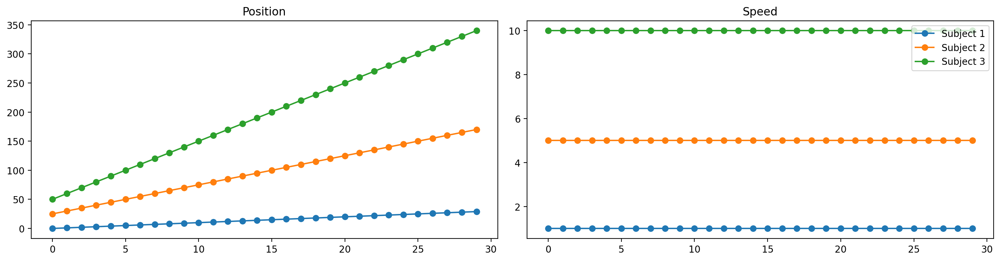

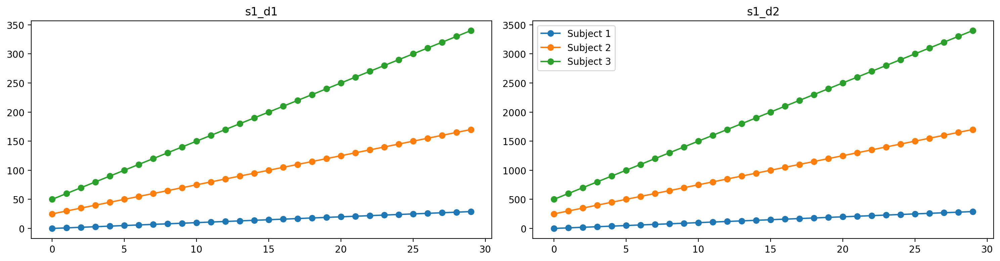

In [29]:
bundle = configure_bundle(
    num_time_steps=30,
    coordination=0,
    noise=0
)
model = FNIRSModel(bundle)
samples = model.draw_samples()
plot_state_space(samples)
plot_observations(samples)

## Coordination = 1

When coordination is maximum, the components instantly share the same speed which is a positive number in this example, leading to a constant increase in their position over time. Notice, however, that because we do not blend position, each component moves in its own scale, which would be equivalent to different people having different baselines for their biological signals. For instance, person A may have a natural lower picth than person B. Coordination will unlikely make person B to adopt person's B pitch but it may influence person A to increase their pitch with respect to person A's baseline if person B does the same with respect to their own pitch baseline.

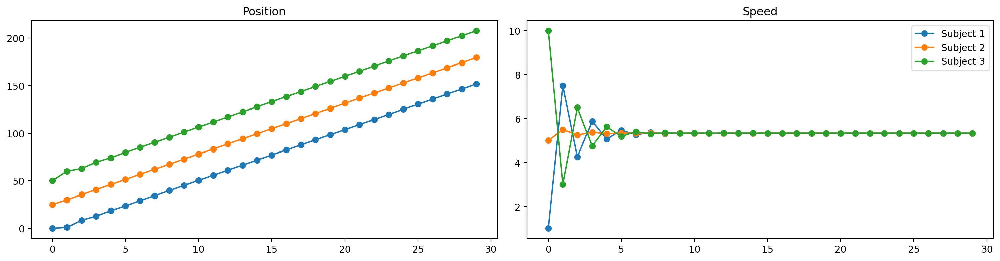

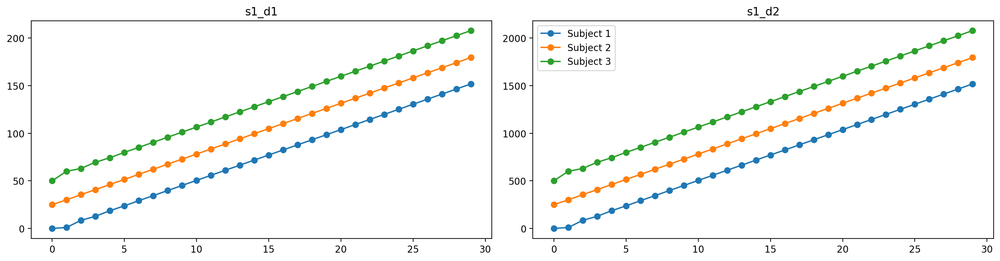

In [30]:
bundle = configure_bundle(
    num_time_steps=30,
    coordination=1,
    noise=0
)
model = FNIRSModel(bundle)
samples = model.draw_samples()
plot_state_space(samples)
plot_observations(samples)

## Coordination = 0.2

As we lower coordination, the slower the component's speed converge to a common value but it still does if coordination persists. This tells us that persistent non-zero coordination in this model leads to convergence given enough time and no noise in the system. There's probably an analytical form to find the time when the speeds converge given some conditions (no variance, no gaps etc.).

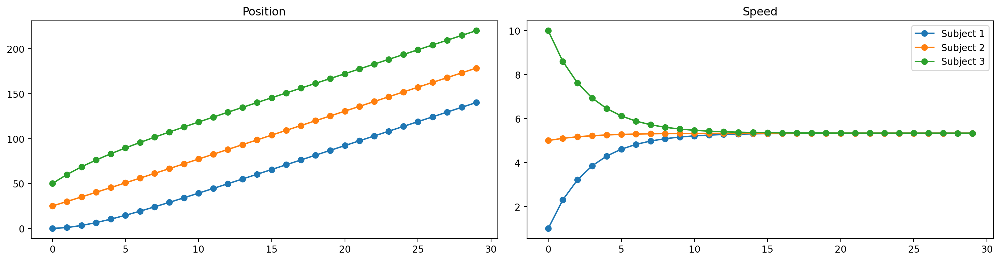

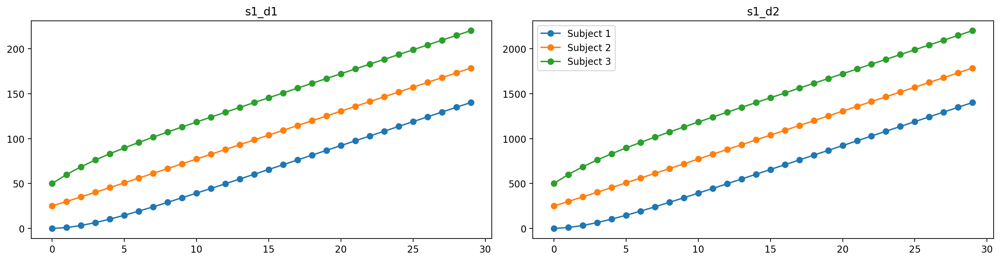

In [36]:
bundle = configure_bundle(
    num_time_steps=30,
    coordination=0.2,
    noise=0
)
model = FNIRSModel(bundle)
samples = model.draw_samples()
plot_state_space(samples)
plot_observations(samples)

# Normalization

In [37]:
bundle = configure_bundle(
    num_time_steps=30,
    coordination=0.2,
    noise=0
)
model = FNIRSModel(bundle)
samples = model.draw_samples()

## No normalization

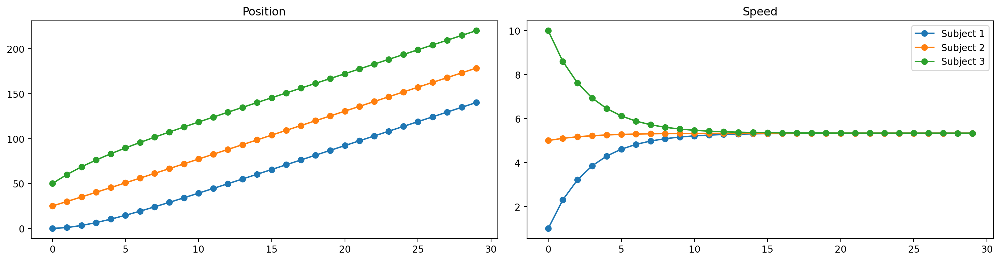

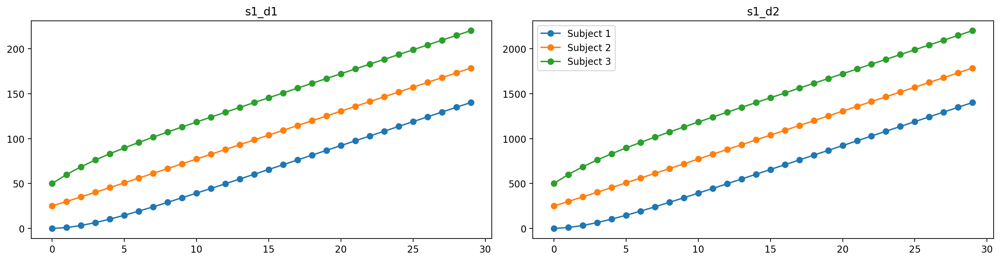

In [38]:
plot_state_space(samples)
plot_observations(samples)

## Normalization per feature

This normalization does not distort the data trend but adjusts each feature to smaller, shared range.

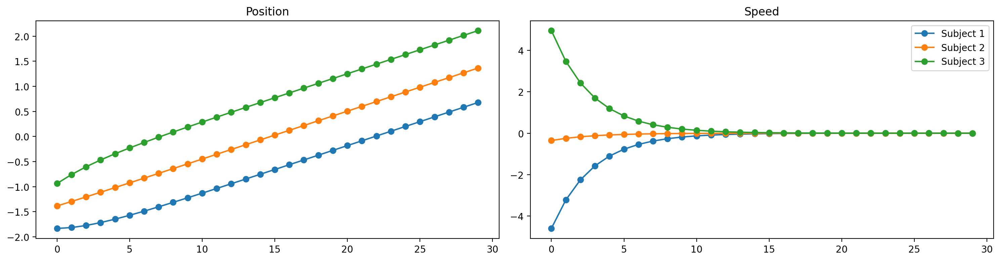

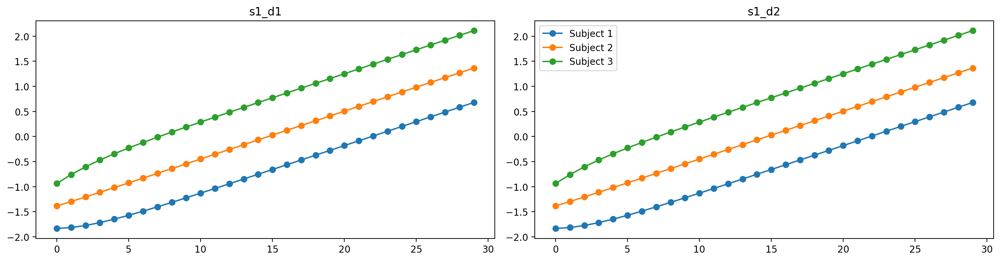

In [43]:
samples_copy = deepcopy(samples)
samples_copy.component_group_samples["neural_activity"].values[0] = normalize_non_serial_data_per_feature(
    data = samples_copy.component_group_samples["neural_activity"].values[0])
samples_copy.component_group_samples["channels"].values[0] = normalize_non_serial_data_per_feature(
    data = samples_copy.component_group_samples["channels"].values[0])
plot_state_space(samples_copy)
plot_observations(samples_copy)

## Normalization per subject and feature

This type of normalization distorts data and should be avoided. Instead, we should fit different mean_a0 per subject to account for interpersonal differences.

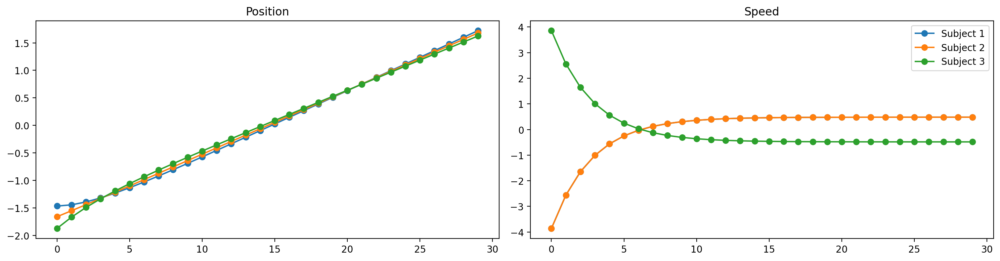

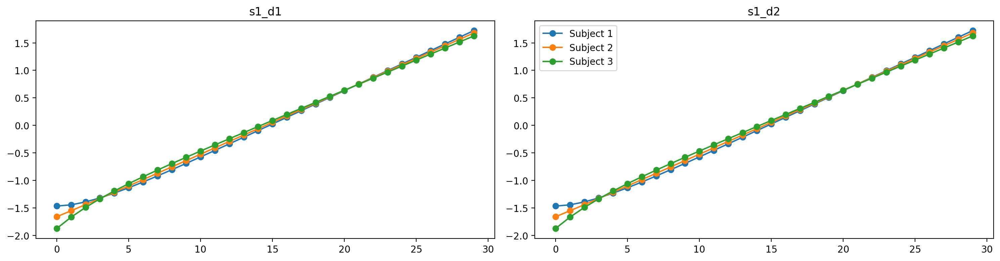

In [44]:
samples_copy = deepcopy(samples)
samples_copy.component_group_samples["neural_activity"].values[0] = normalize_non_serial_data_per_subject_and_feature(
    data = samples_copy.component_group_samples["neural_activity"].values[0])
samples_copy.component_group_samples["channels"].values[0] = normalize_non_serial_data_per_subject_and_feature(
    data = samples_copy.component_group_samples["channels"].values[0])
plot_state_space(samples_copy)
plot_observations(samples_copy)

# Inference

## a. Constant coordination small noise (0.01)

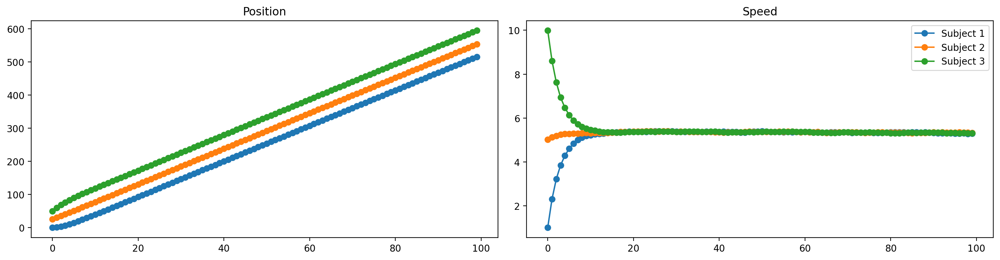

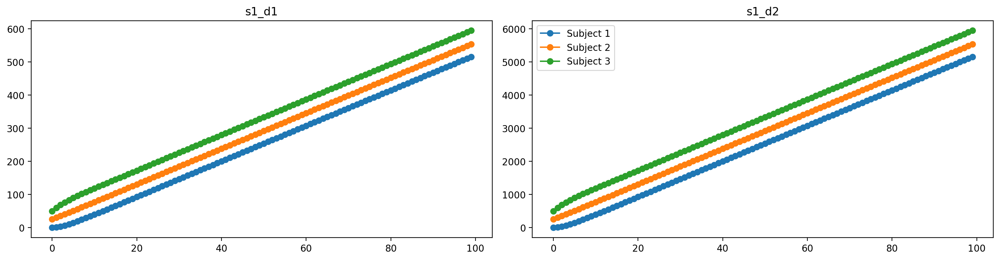

In [54]:
template_bundle_a = configure_bundle(
    num_time_steps=100,
    coordination=0.2,
    noise=0.01
)

model = FNIRSModel(deepcopy(template_bundle_a))
data_a = model.draw_samples()
update_config_bundle_from_samples(template_bundle_a, data_a)

plot_state_space(data_a)
plot_observations(data_a)

### a1. No given parameters

Auto-assigning NUTS sampler...
INFO:pymc:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, neural_activity_mean_a0, neural_activity_sd_a, neural_activity, channels_sd_o]
INFO:pymc:NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, neural_activity_mean_a0, neural_activity_sd_a, neural_activity, channels_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 1171 seconds.
INFO:pymc:Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 1171 seconds.


                  variable converged  mean_rhat  std_rhat
0    coordination_mean_uc0        no   1.170859  0.000000
1   unbounded_coordination        no   1.268143  0.103296
2  neural_activity_mean_a0       yes   1.001392  0.001550
3          neural_activity       yes   1.000571  0.001126
4       coordination_sd_uc        no   1.626731  0.000000
5     neural_activity_sd_a       yes   1.003345  0.000000
6            channels_sd_o       yes   1.000964  0.000000
7             coordination        no   1.269684  0.105219


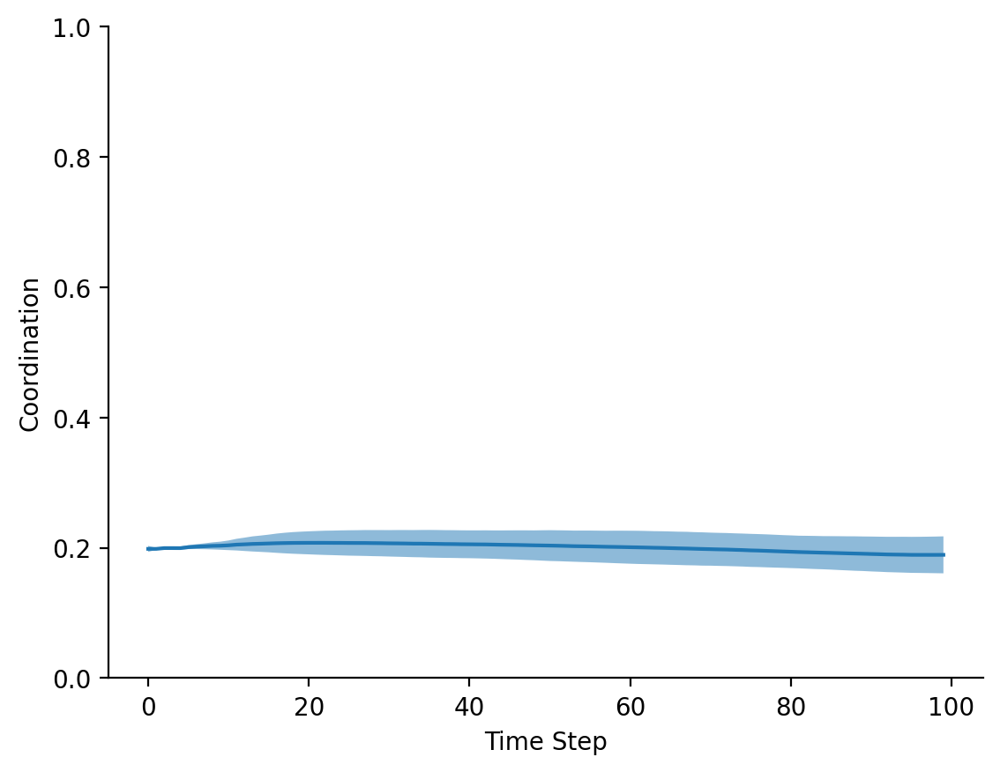

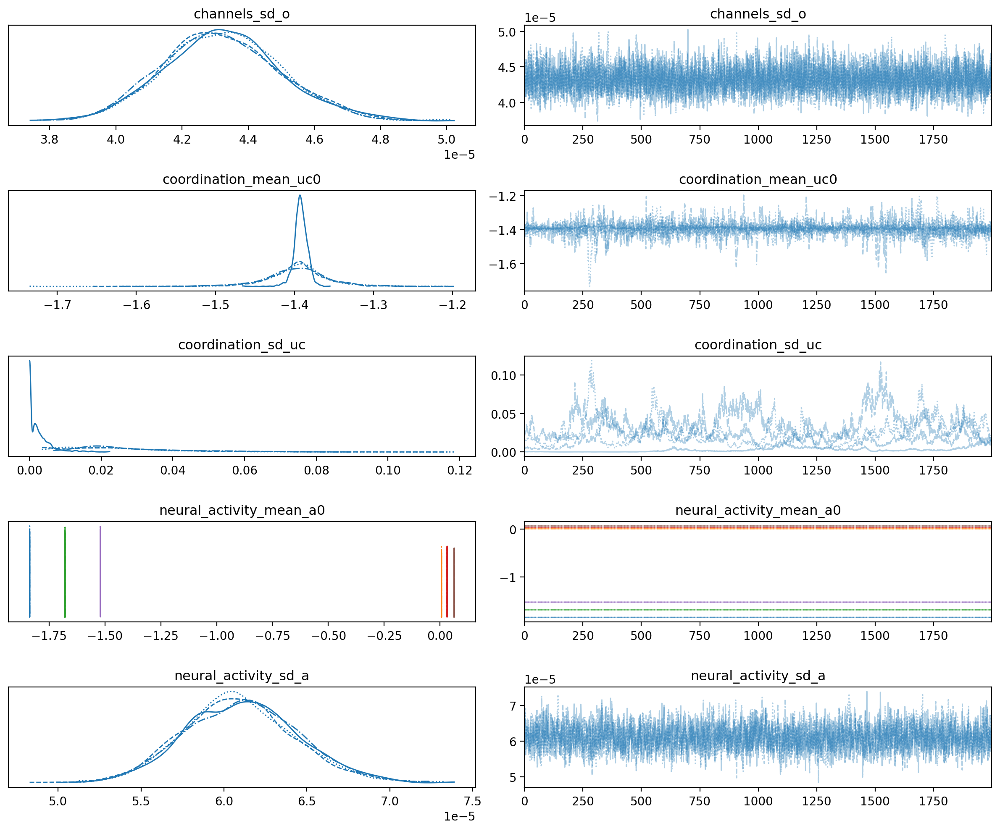

In [57]:
model = FNIRSModel(deepcopy(template_bundle_a))

model.config_bundle.sd_a = None
model.config_bundle.sd_o = None
model.config_bundle.mean_a0 = None
model.config_bundle.mean_uc0 = None
model.config_bundle.sd_uc = None
model.config_bundle.weights = [np.array([[1,1]])] # Important if normalization per feature is used

idata_a1 = train(model)

#### State space estimation

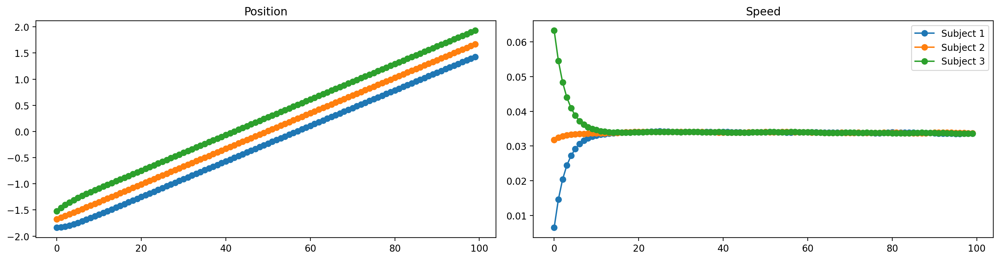

In [59]:
data_cp = deepcopy(data_a)
data_cp.component_group_samples["neural_activity"].values[0] = idata_a1.average_posterior_samples("neural_activity", return_std=False)
plot_state_space(data_cp)

### a2. Fixed sd_uc = 0.01

Auto-assigning NUTS sampler...
INFO:pymc:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, unbounded_coordination, neural_activity_mean_a0, neural_activity_sd_a, neural_activity, channels_sd_o]
INFO:pymc:NUTS: [coordination_mean_uc0, unbounded_coordination, neural_activity_mean_a0, neural_activity_sd_a, neural_activity, channels_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 520 seconds.
INFO:pymc:Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 520 seconds.


                  variable converged  mean_rhat  std_rhat
0    coordination_mean_uc0       yes   1.000698  0.000000
1   unbounded_coordination       yes   1.005176  0.002235
2  neural_activity_mean_a0       yes   1.000233  0.000127
3          neural_activity       yes   1.000456  0.000483
4     neural_activity_sd_a       yes   1.001107  0.000000
5            channels_sd_o       yes   1.001169  0.000000
6             coordination       yes   1.005242  0.002270


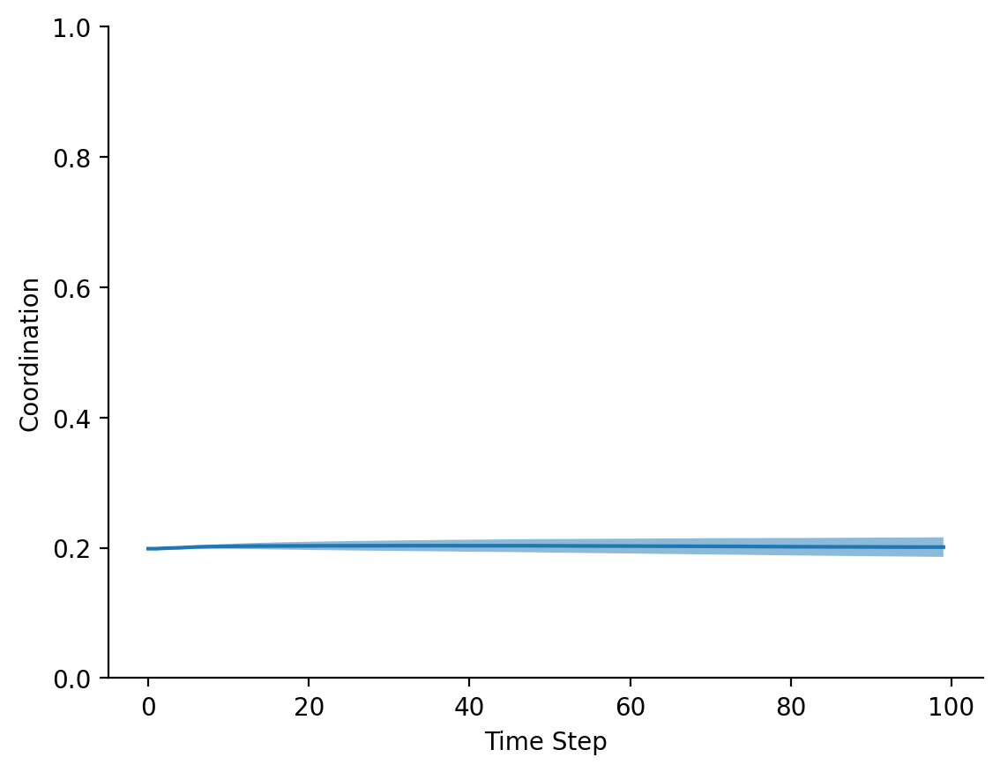

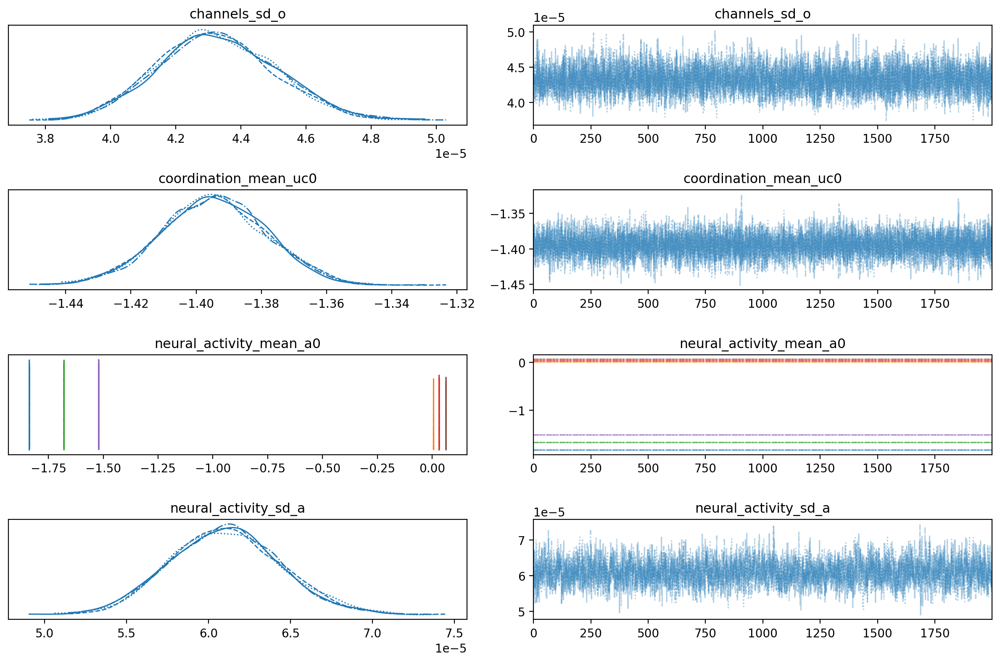

In [60]:
model = FNIRSModel(deepcopy(template_bundle_a))

model.config_bundle.sd_a = None
model.config_bundle.sd_o = None
model.config_bundle.mean_a0 = None
model.config_bundle.mean_uc0 = None
model.config_bundle.sd_uc = 0.01
model.config_bundle.weights = [np.array([[1,1]])] # Important if normalization per feature is used

idata_a2 = train(model)

#### State space estimation

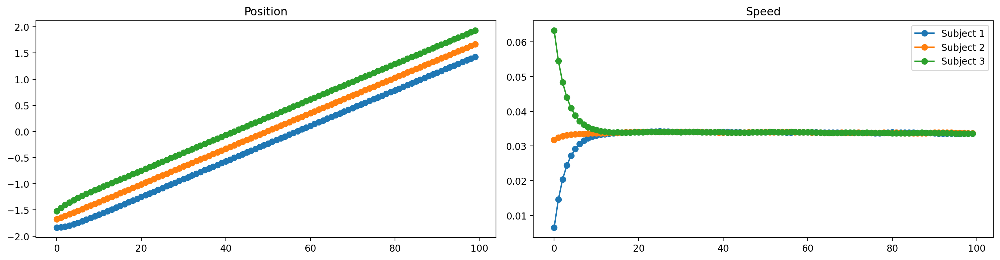

In [62]:
data_cp = deepcopy(data_a)
data_cp.component_group_samples["neural_activity"].values[0] = idata_a2.average_posterior_samples("neural_activity", return_std=False)
plot_state_space(data_cp)

### a3. Tighter prior for sd_uc

Auto-assigning NUTS sampler...
INFO:pymc:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, neural_activity_mean_a0, neural_activity_sd_a, neural_activity, channels_sd_o]
INFO:pymc:NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, neural_activity_mean_a0, neural_activity_sd_a, neural_activity, channels_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 946 seconds.
INFO:pymc:Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 946 seconds.


                  variable converged  mean_rhat  std_rhat
0    coordination_mean_uc0       yes   1.013235  0.000000
1   unbounded_coordination        no   1.138025  0.049861
2  neural_activity_mean_a0       yes   1.000374  0.000281
3          neural_activity       yes   1.000444  0.000468
4       coordination_sd_uc       yes   1.080797  0.000000
5     neural_activity_sd_a       yes   1.001059  0.000000
6            channels_sd_o       yes   1.000098  0.000000
7             coordination        no   1.138025  0.049860


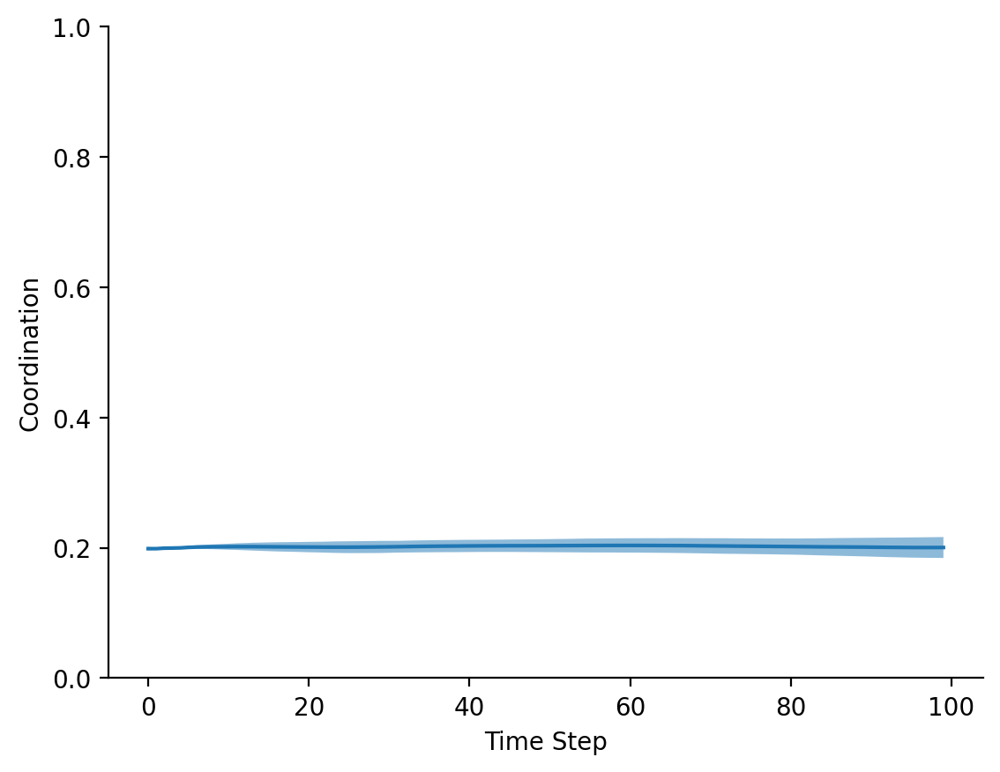

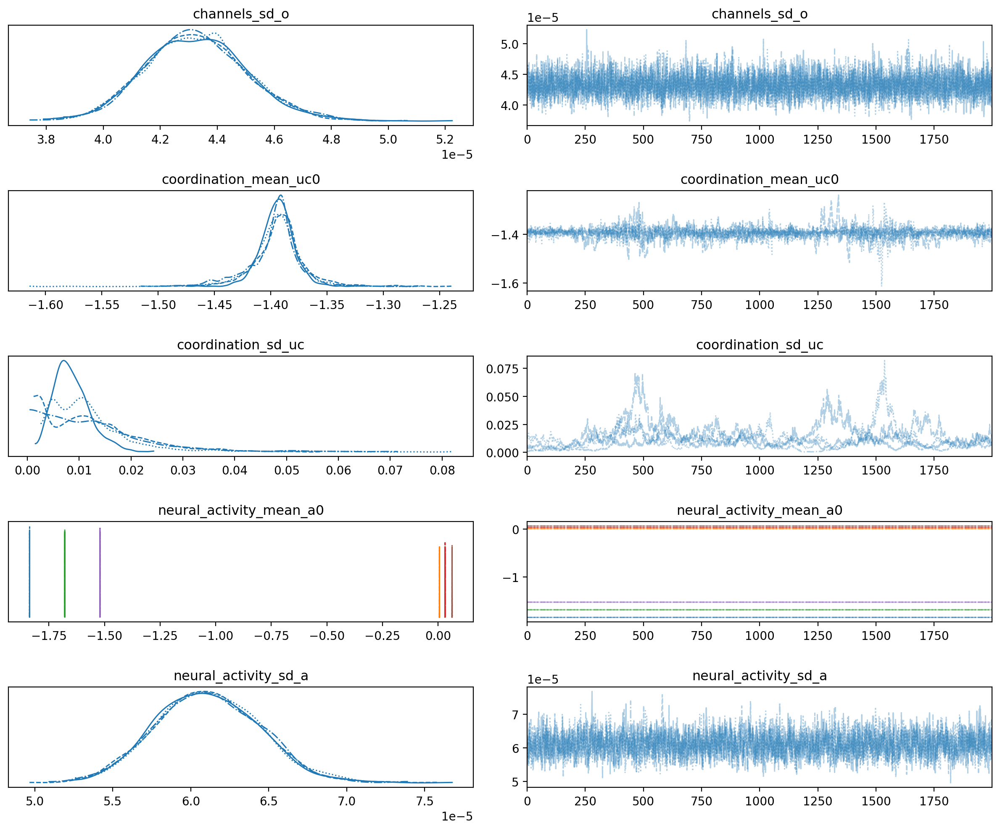

In [63]:
model = FNIRSModel(deepcopy(template_bundle_a))

model.config_bundle.sd_a = None
model.config_bundle.sd_o = None
model.config_bundle.mean_a0 = None
model.config_bundle.mean_uc0 = None
model.config_bundle.sd_uc = None
model.config_bundle.sd_sd_uc = 0.1
model.config_bundle.weights = [np.array([[1,1]])] # Important if normalization per feature is used

idata_a3 = train(model)

#### State space estimation

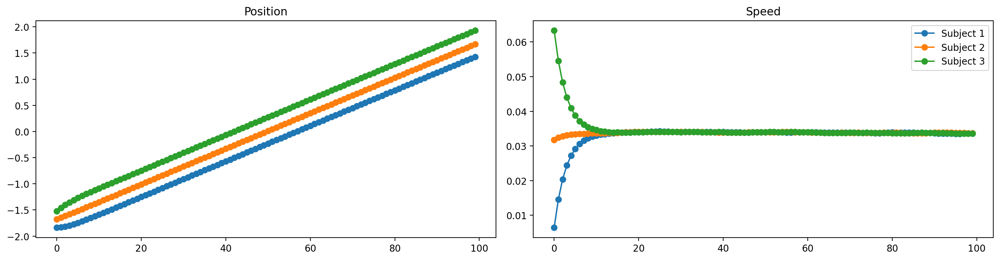

In [64]:
data_cp = deepcopy(data_a)
data_cp.component_group_samples["neural_activity"].values[0] = idata_a3.average_posterior_samples("neural_activity", return_std=False)
plot_state_space(data_cp)

### a4. No given parameters (longer burn-in)

Auto-assigning NUTS sampler...
INFO:pymc:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, neural_activity_mean_a0, neural_activity_sd_a, neural_activity, channels_sd_o]
INFO:pymc:NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, neural_activity_mean_a0, neural_activity_sd_a, neural_activity, channels_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 4_000 tune and 2_000 draw iterations (16_000 + 8_000 draws total) took 2038 seconds.
INFO:pymc:Sampling 4 chains for 4_000 tune and 2_000 draw iterations (16_000 + 8_000 draws total) took 2038 seconds.


                  variable converged  mean_rhat  std_rhat
0    coordination_mean_uc0        no   1.295578  0.000000
1   unbounded_coordination        no   1.407914  0.162944
2  neural_activity_mean_a0       yes   1.004504  0.005842
3          neural_activity       yes   1.000768  0.001972
4       coordination_sd_uc        no   1.844305  0.000000
5     neural_activity_sd_a       yes   1.002571  0.000000
6            channels_sd_o       yes   1.000410  0.000000
7             coordination        no   1.408297  0.162720


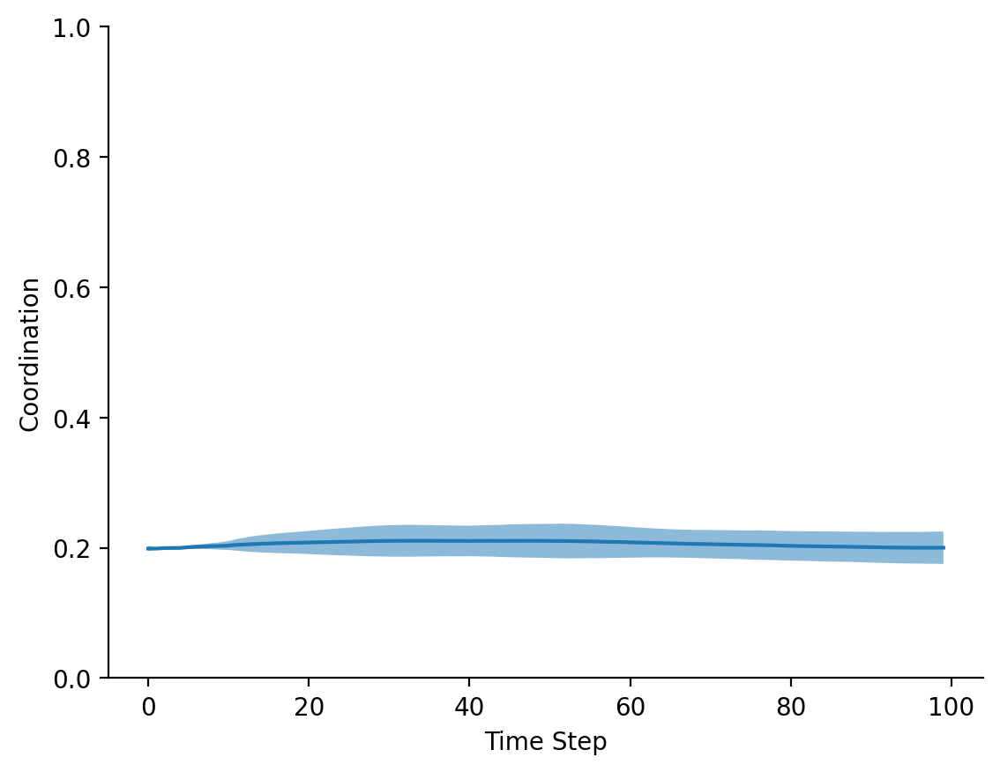

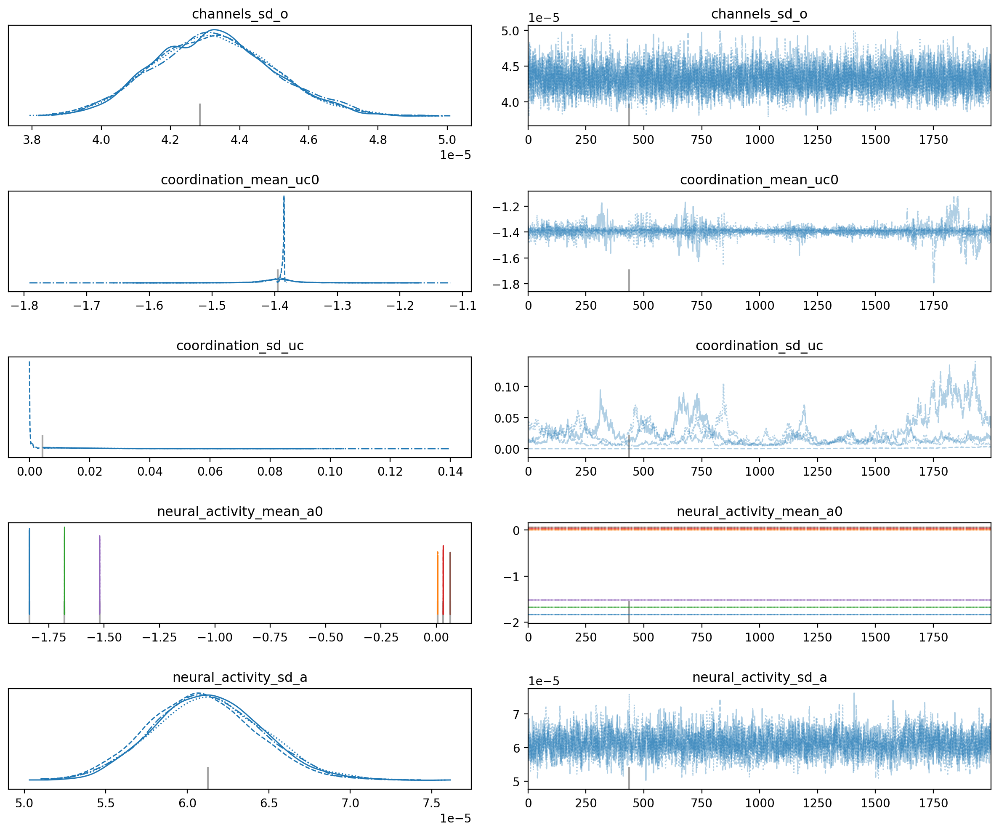

In [65]:
model = FNIRSModel(deepcopy(template_bundle_a))

model.config_bundle.sd_a = None
model.config_bundle.sd_o = None
model.config_bundle.mean_a0 = None
model.config_bundle.mean_uc0 = None
model.config_bundle.sd_uc = None
model.config_bundle.weights = [np.array([[1,1]])] # Important if normalization per feature is used

idata_a4 = train(model, burn_in=4000)

#### State space estimation

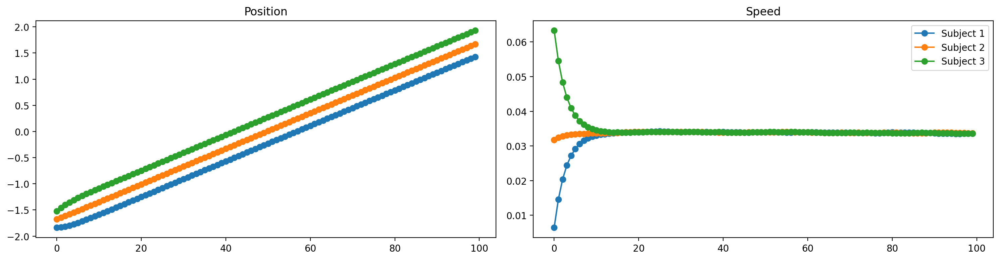

In [66]:
data_cp = deepcopy(data_a)
data_cp.component_group_samples["neural_activity"].values[0] = idata_a4.average_posterior_samples("neural_activity", return_std=False)
plot_state_space(data_cp)

## b. Constant coordination large noise (1)

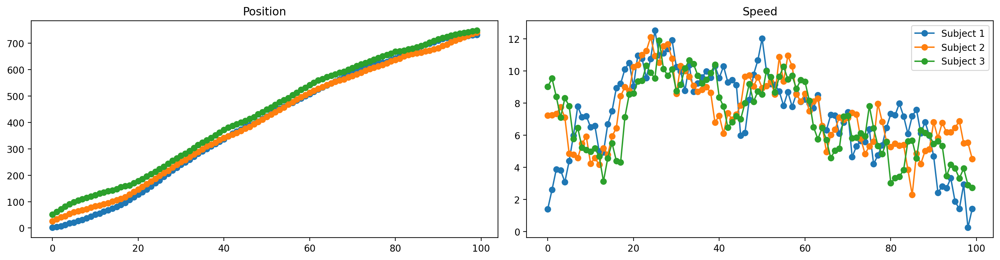

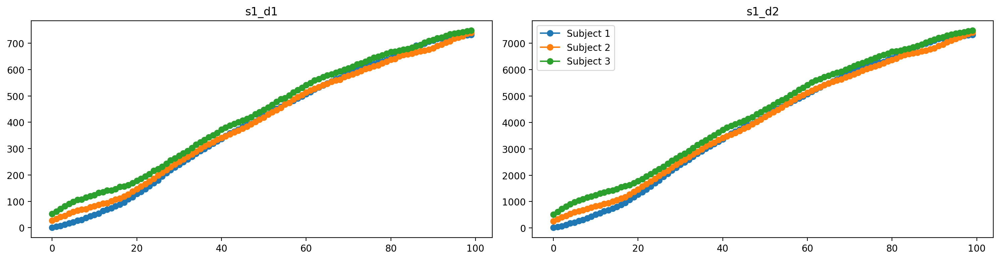

In [67]:
template_bundle_b = configure_bundle(
    num_time_steps=100,
    coordination=0.2,
    noise=1
)

model = FNIRSModel(deepcopy(template_bundle_b))
data_b = model.draw_samples()
update_config_bundle_from_samples(template_bundle_b, data_b)

plot_state_space(data_b)
plot_observations(data_b)

### b1. No given parameters

Auto-assigning NUTS sampler...
INFO:pymc:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, neural_activity_mean_a0, neural_activity_sd_a, neural_activity, channels_sd_o]
INFO:pymc:NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, neural_activity_mean_a0, neural_activity_sd_a, neural_activity, channels_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 311 seconds.
INFO:pymc:Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 311 seconds.


                  variable converged  mean_rhat  std_rhat
0    coordination_mean_uc0       yes   1.011650  0.000000
1   unbounded_coordination       yes   1.044369  0.022381
2  neural_activity_mean_a0       yes   1.023713  0.020266
3          neural_activity       yes   1.021684  0.018338
4       coordination_sd_uc        no   1.189332  0.000000
5     neural_activity_sd_a       yes   1.024484  0.000000
6            channels_sd_o       yes   1.006914  0.000000
7             coordination       yes   1.041862  0.020341


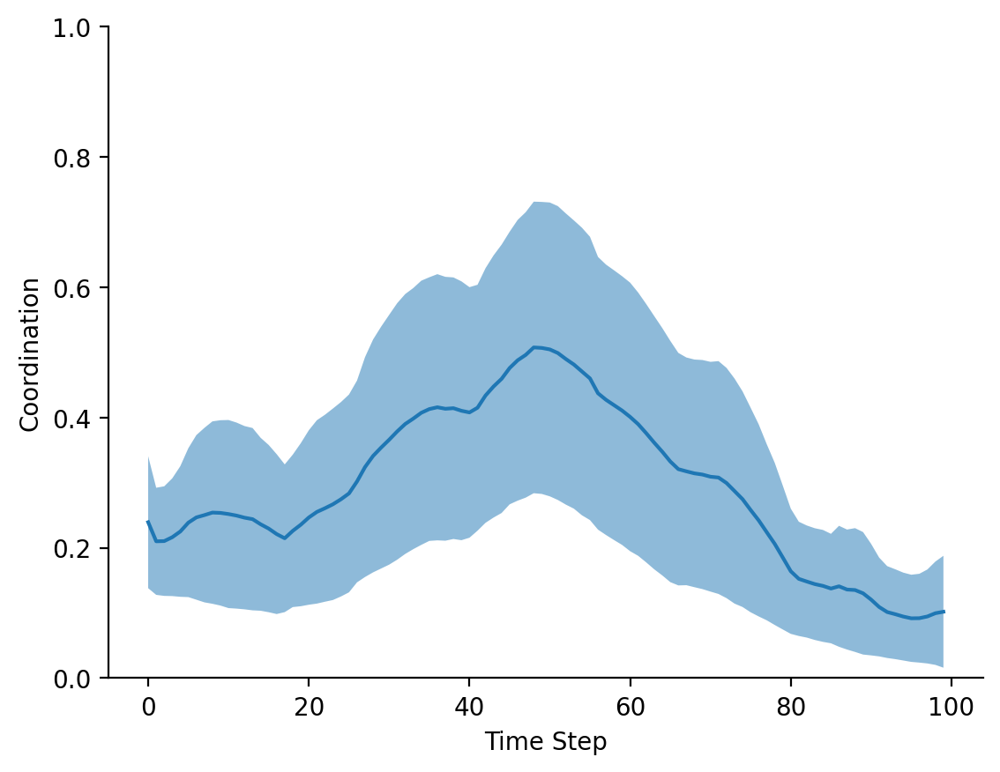

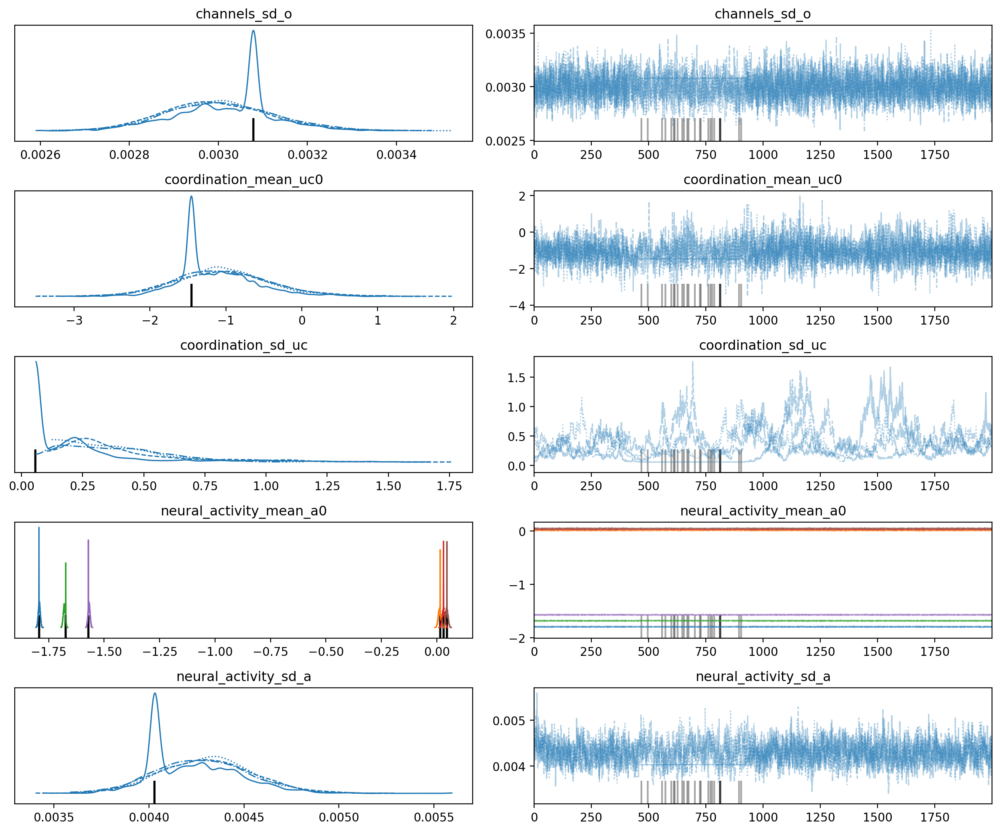

In [68]:
model = FNIRSModel(deepcopy(template_bundle_b))

model.config_bundle.sd_a = None
model.config_bundle.sd_o = None
model.config_bundle.mean_a0 = None
model.config_bundle.mean_uc0 = None
model.config_bundle.sd_uc = None
model.config_bundle.weights = [np.array([[1,1]])] # Important if normalization per feature is used

idata_b1 = train(model)

#### State space estimation

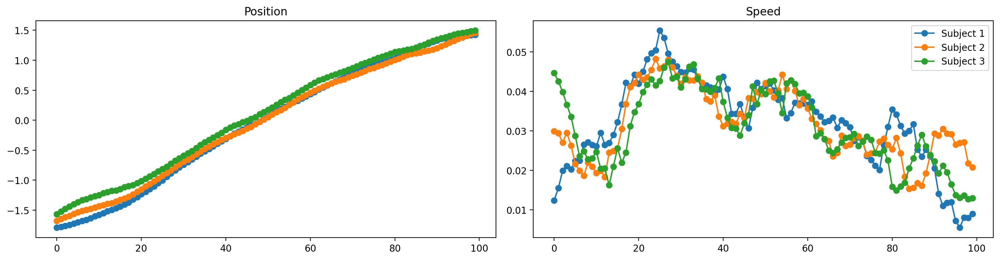

In [69]:
data_cp = deepcopy(data_b)
data_cp.component_group_samples["neural_activity"].values[0] = idata_b1.average_posterior_samples("neural_activity", return_std=False)
plot_state_space(data_cp)

### b2. Fixed sd_uc = 0.01

Auto-assigning NUTS sampler...
INFO:pymc:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, unbounded_coordination, neural_activity_mean_a0, neural_activity_sd_a, neural_activity, channels_sd_o]
INFO:pymc:NUTS: [coordination_mean_uc0, unbounded_coordination, neural_activity_mean_a0, neural_activity_sd_a, neural_activity, channels_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 785 seconds.
INFO:pymc:Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 785 seconds.


                  variable converged  mean_rhat  std_rhat
0    coordination_mean_uc0        no   1.374603  0.000000
1   unbounded_coordination        no   1.367239  0.012061
2  neural_activity_mean_a0       yes   1.000877  0.000854
3          neural_activity       yes   1.000743  0.000839
4     neural_activity_sd_a       yes   1.030350  0.000000
5            channels_sd_o       yes   1.002007  0.000000
6             coordination        no   1.367239  0.012061


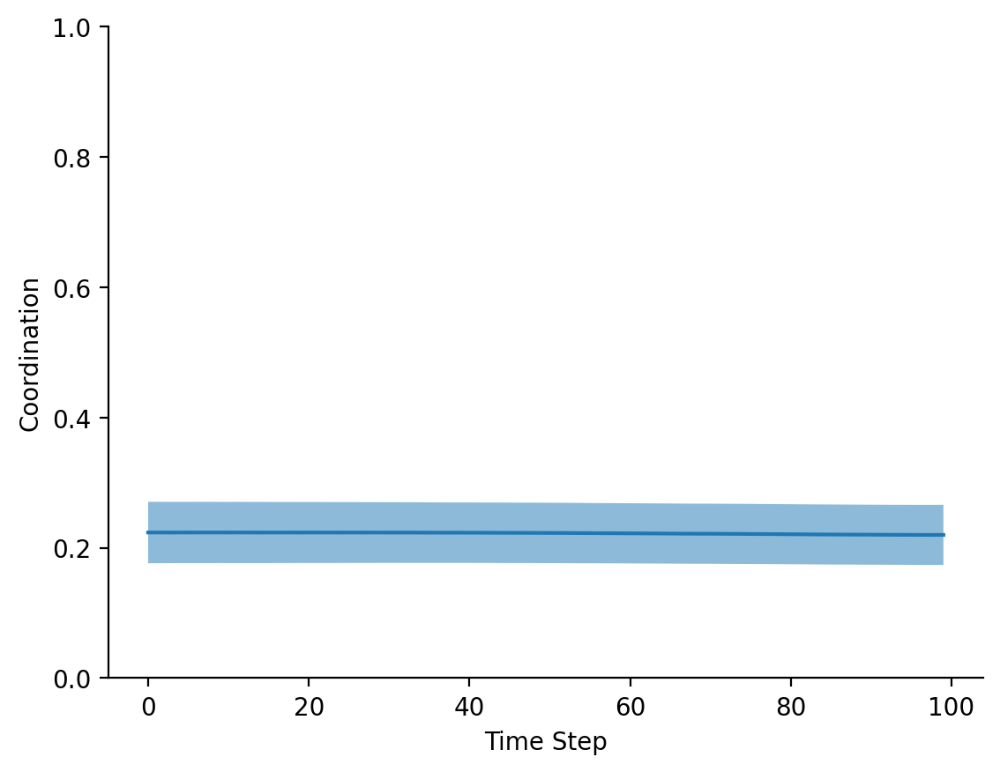

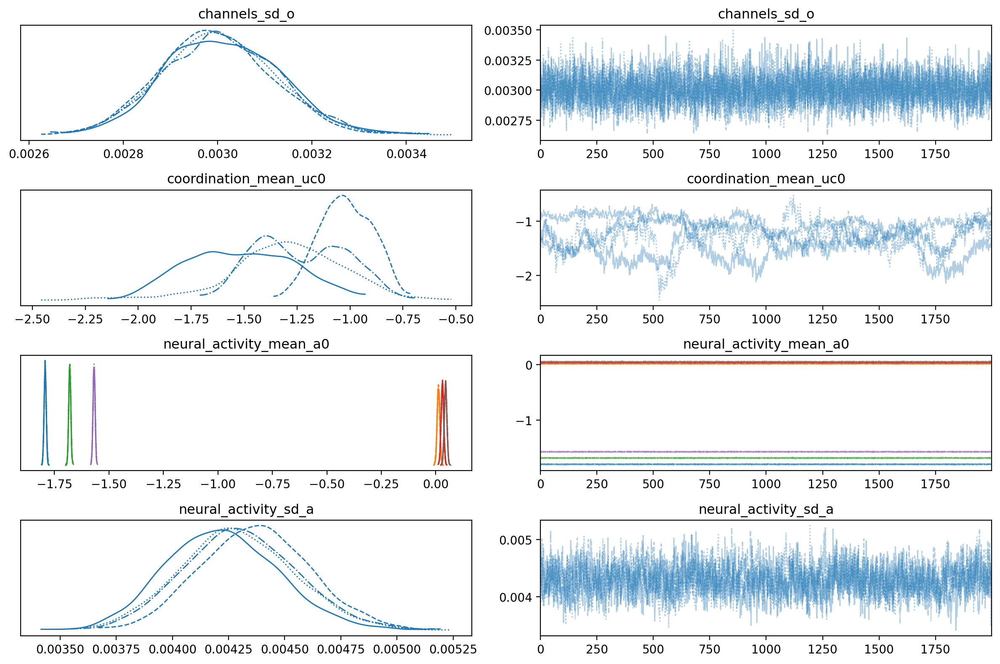

In [70]:
model = FNIRSModel(deepcopy(template_bundle_b))

model.config_bundle.sd_a = None
model.config_bundle.sd_o = None
model.config_bundle.mean_a0 = None
model.config_bundle.mean_uc0 = None
model.config_bundle.sd_uc = 0.01
model.config_bundle.weights = [np.array([[1,1]])] # Important if normalization per feature is used

idata_b2 = train(model)

#### State space estimation

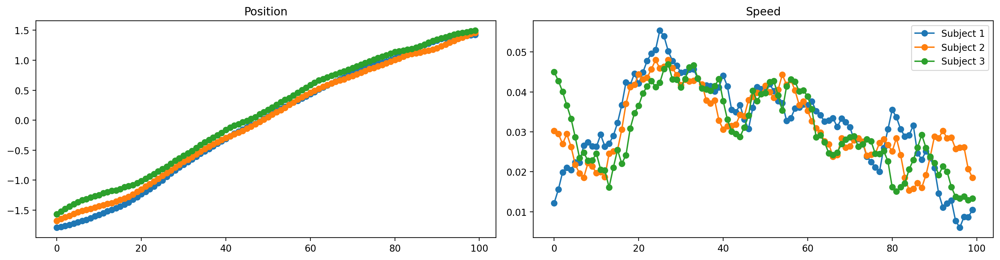

In [71]:
data_cp = deepcopy(data_b)
data_cp.component_group_samples["neural_activity"].values[0] = idata_b2.average_posterior_samples("neural_activity", return_std=False)
plot_state_space(data_cp)

### b3. Fixed sd_uc = 0.1

Auto-assigning NUTS sampler...
INFO:pymc:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, unbounded_coordination, neural_activity_mean_a0, neural_activity_sd_a, neural_activity, channels_sd_o]
INFO:pymc:NUTS: [coordination_mean_uc0, unbounded_coordination, neural_activity_mean_a0, neural_activity_sd_a, neural_activity, channels_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 303 seconds.
INFO:pymc:Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 303 seconds.


                  variable converged  mean_rhat  std_rhat
0    coordination_mean_uc0       yes   1.004821  0.000000
1   unbounded_coordination       yes   1.013389  0.004299
2  neural_activity_mean_a0       yes   1.000869  0.000327
3          neural_activity       yes   1.000428  0.000454
4     neural_activity_sd_a       yes   1.004001  0.000000
5            channels_sd_o       yes   1.000384  0.000000
6             coordination       yes   1.013389  0.004299


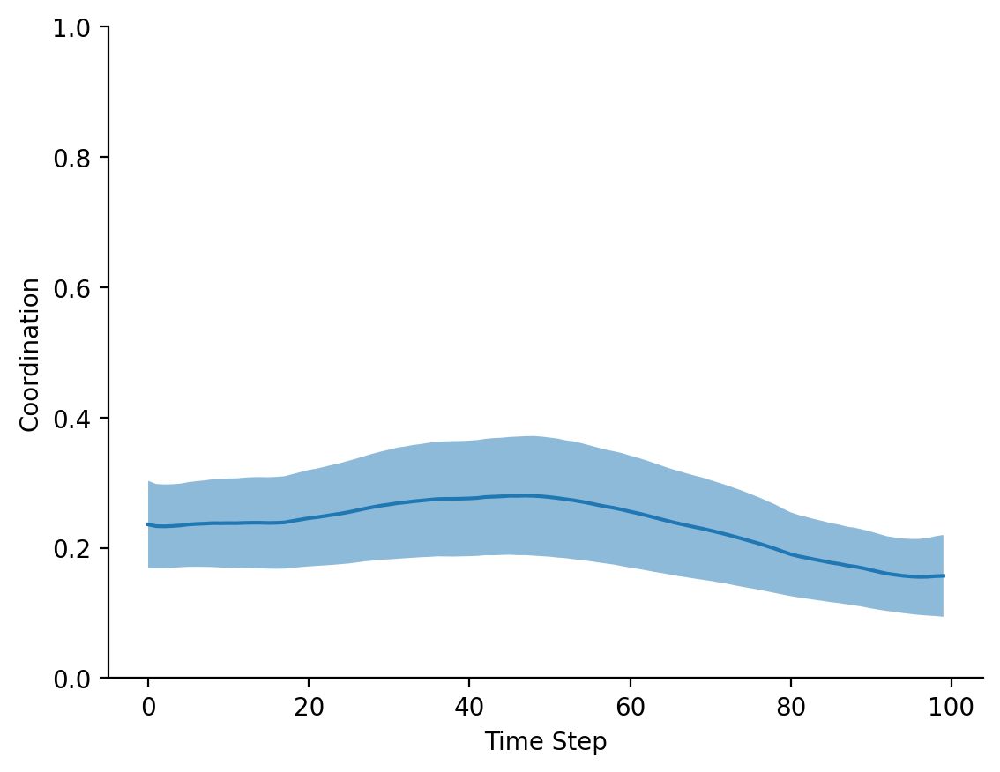

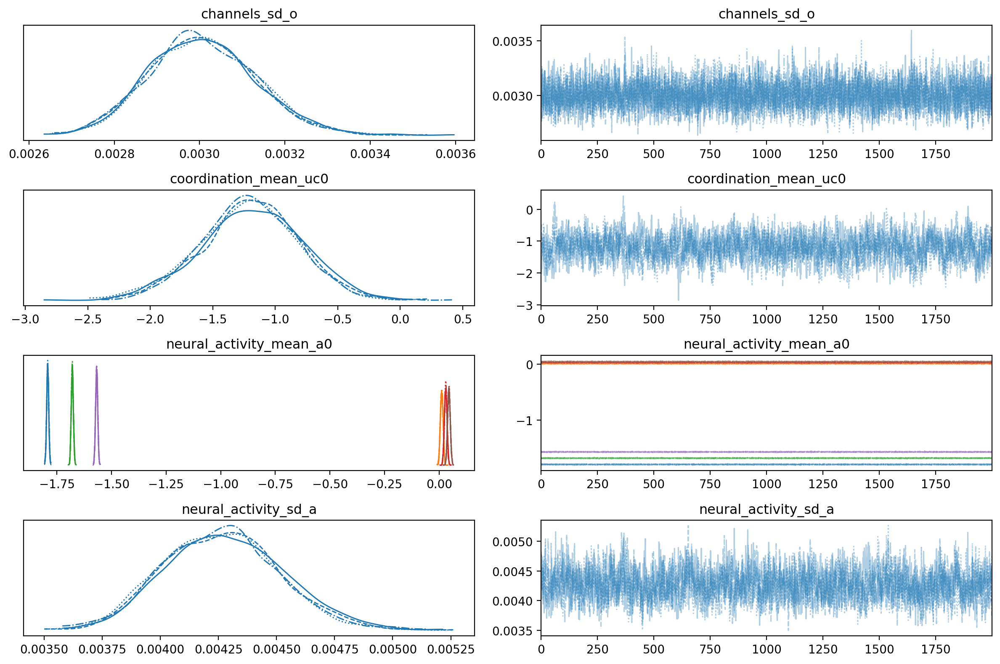

In [72]:
model = FNIRSModel(deepcopy(template_bundle_b))

model.config_bundle.sd_a = None
model.config_bundle.sd_o = None
model.config_bundle.mean_a0 = None
model.config_bundle.mean_uc0 = None
model.config_bundle.sd_uc = 0.1
model.config_bundle.weights = [np.array([[1,1]])] # Important if normalization per feature is used

idata_b3 = train(model)

#### State space estimation

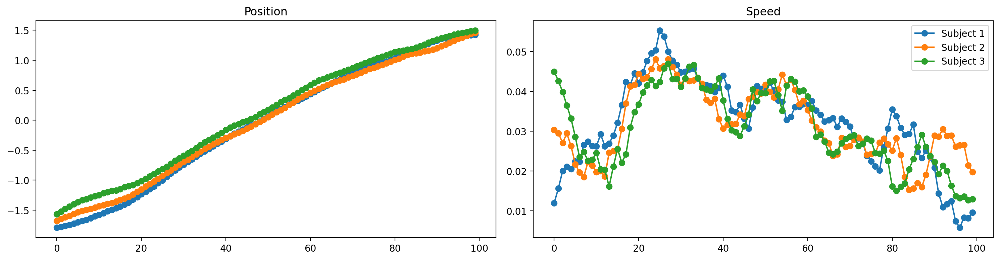

In [73]:
data_cp = deepcopy(data_b)
data_cp.component_group_samples["neural_activity"].values[0] = idata_b3.average_posterior_samples("neural_activity", return_std=False)
plot_state_space(data_cp)

## c. Single peak coordination small noise (0.01)

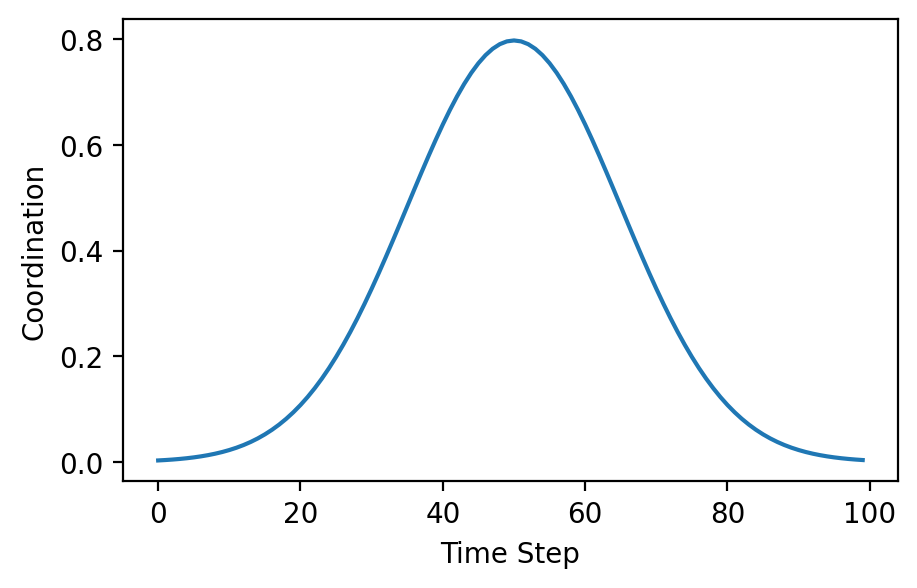

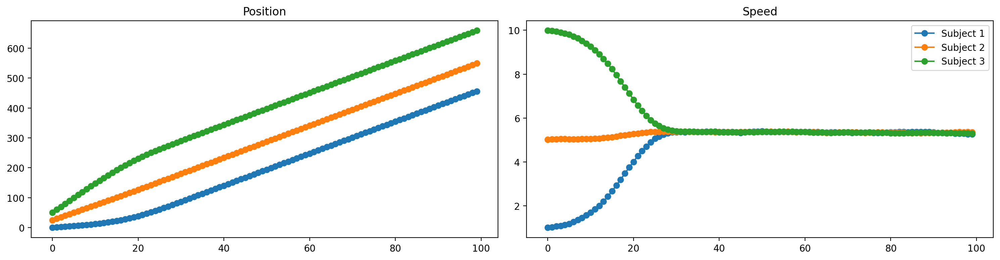

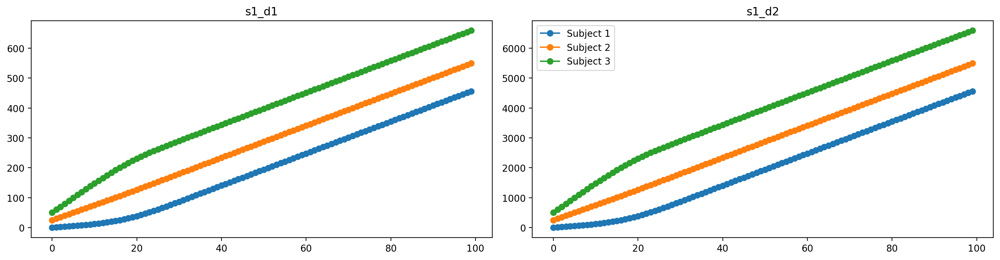

In [75]:
coordination = 30 * norm(loc=50, scale=15).pdf(np.arange(100))
template_bundle_c = configure_bundle(
    num_time_steps=100,
    coordination=coordination,
    noise=0.01
)

model = FNIRSModel(deepcopy(template_bundle_c))
data_c = model.draw_samples()
update_config_bundle_from_samples(template_bundle_c, data_c)

fig = plt.figure(figsize=(5,3))	
plt.plot(np.arange(100), coordination)
plt.xlabel("Time Step")
plt.ylabel("Coordination")
plot_state_space(data_c)
plot_observations(data_c)

### c1. No given parameters

Auto-assigning NUTS sampler...
INFO:pymc:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, neural_activity_mean_a0, neural_activity_sd_a, neural_activity, channels_sd_o]
INFO:pymc:NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, neural_activity_mean_a0, neural_activity_sd_a, neural_activity, channels_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 336 seconds.
INFO:pymc:Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 336 seconds.


                  variable converged  mean_rhat  std_rhat
0    coordination_mean_uc0       yes   1.002715  0.000000
1   unbounded_coordination       yes   1.003217  0.002385
2  neural_activity_mean_a0       yes   1.000298  0.000394
3          neural_activity       yes   1.000447  0.000462
4       coordination_sd_uc       yes   1.010967  0.000000
5     neural_activity_sd_a       yes   1.000633  0.000000
6            channels_sd_o       yes   1.000237  0.000000
7             coordination       yes   1.003220  0.002382


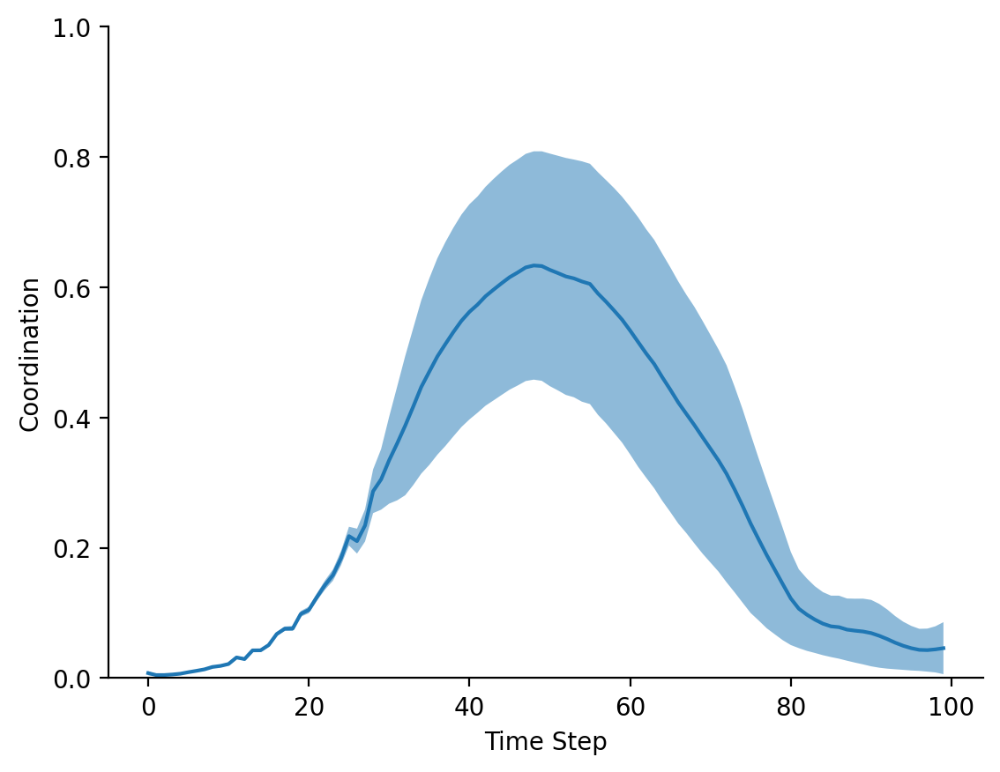

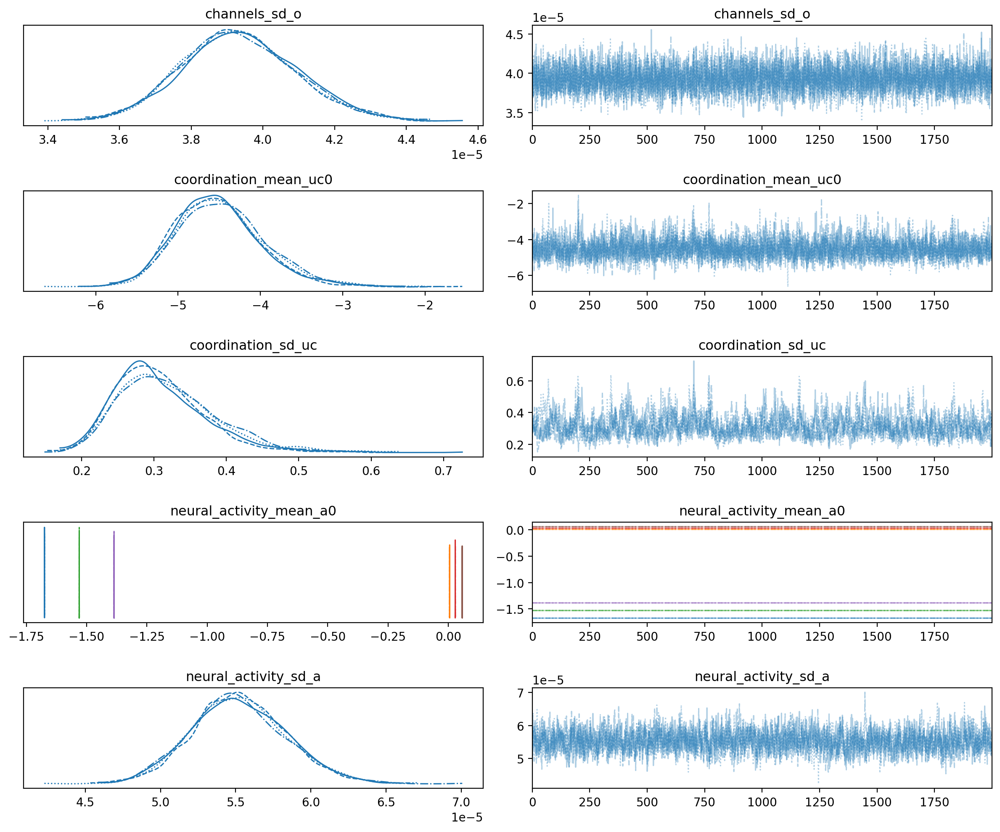

In [76]:
model = FNIRSModel(deepcopy(template_bundle_c))

model.config_bundle.sd_a = None
model.config_bundle.sd_o = None
model.config_bundle.mean_a0 = None
model.config_bundle.mean_uc0 = None
model.config_bundle.sd_uc = None
model.config_bundle.weights = [np.array([[1,1]])] # Important if normalization per feature is used

idata_c1 = train(model)

#### State space estimation

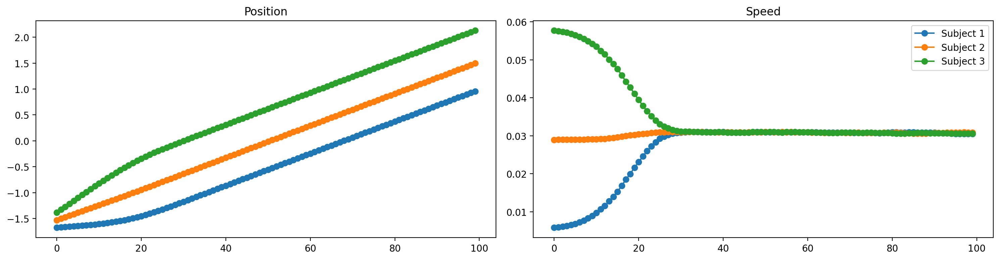

In [77]:
data_cp = deepcopy(data_c)
data_cp.component_group_samples["neural_activity"].values[0] = idata_c1.average_posterior_samples("neural_activity", return_std=False)
plot_state_space(data_cp)

### c2. Fixed sd_uc = 0.1

Auto-assigning NUTS sampler...
INFO:pymc:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, unbounded_coordination, neural_activity_mean_a0, neural_activity_sd_a, neural_activity, channels_sd_o]
INFO:pymc:NUTS: [coordination_mean_uc0, unbounded_coordination, neural_activity_mean_a0, neural_activity_sd_a, neural_activity, channels_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 435 seconds.
INFO:pymc:Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 435 seconds.


                  variable converged  mean_rhat  std_rhat
0    coordination_mean_uc0       yes   1.001185  0.000000
1   unbounded_coordination       yes   1.005448  0.003696
2  neural_activity_mean_a0       yes   1.000255  0.000238
3          neural_activity       yes   1.000452  0.000468
4     neural_activity_sd_a       yes   1.002794  0.000000
5            channels_sd_o       yes   1.000822  0.000000
6             coordination       yes   1.005449  0.003695


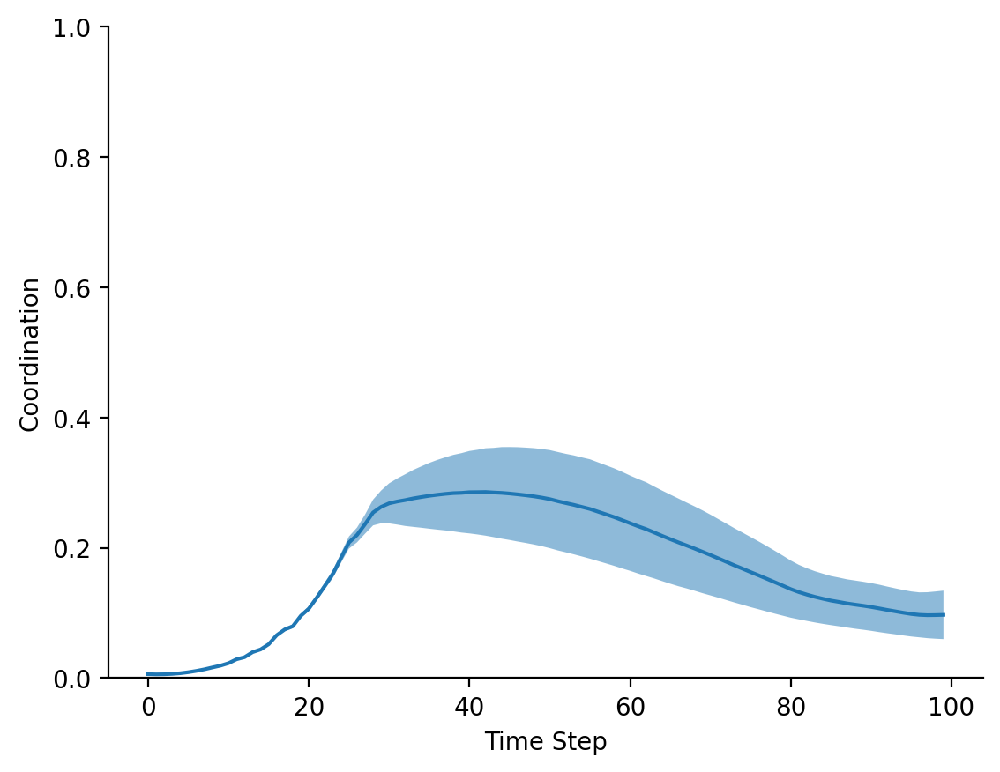

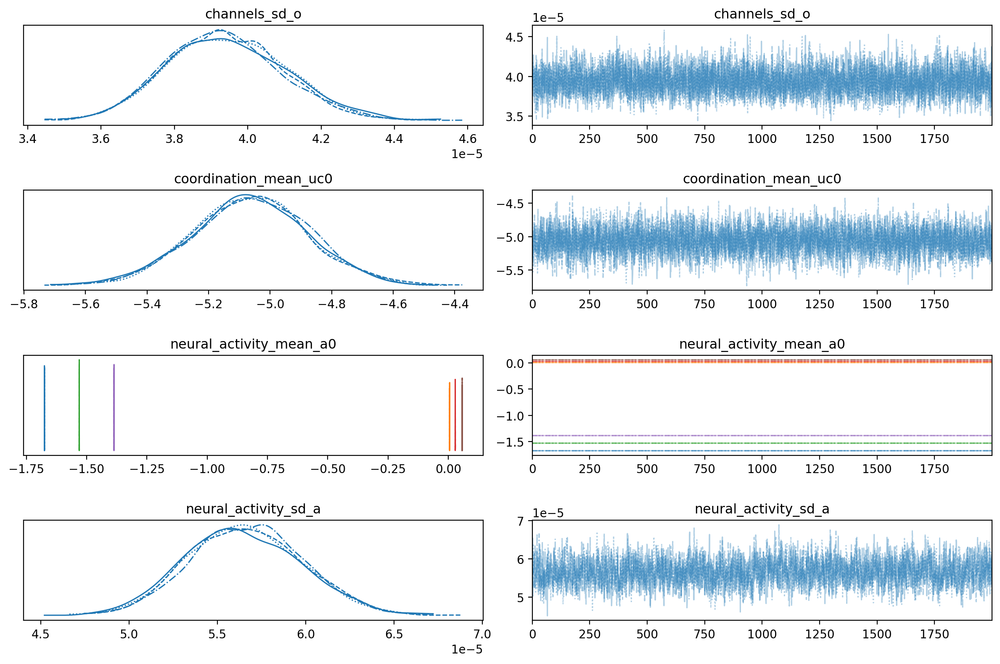

In [78]:
model = FNIRSModel(deepcopy(template_bundle_c))

model.config_bundle.sd_a = None
model.config_bundle.sd_o = None
model.config_bundle.mean_a0 = None
model.config_bundle.mean_uc0 = None
model.config_bundle.sd_uc = 0.1
model.config_bundle.weights = [np.array([[1,1]])] # Important if normalization per feature is used

idata_c2 = train(model)

#### State space estimation

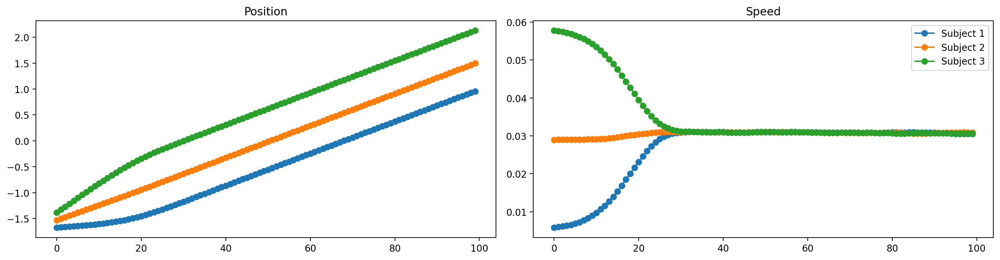

In [79]:
data_cp = deepcopy(data_c)
data_cp.component_group_samples["neural_activity"].values[0] = idata_c2.average_posterior_samples("neural_activity", return_std=False)
plot_state_space(data_cp)

## d. Single peak coordination large noise (1)

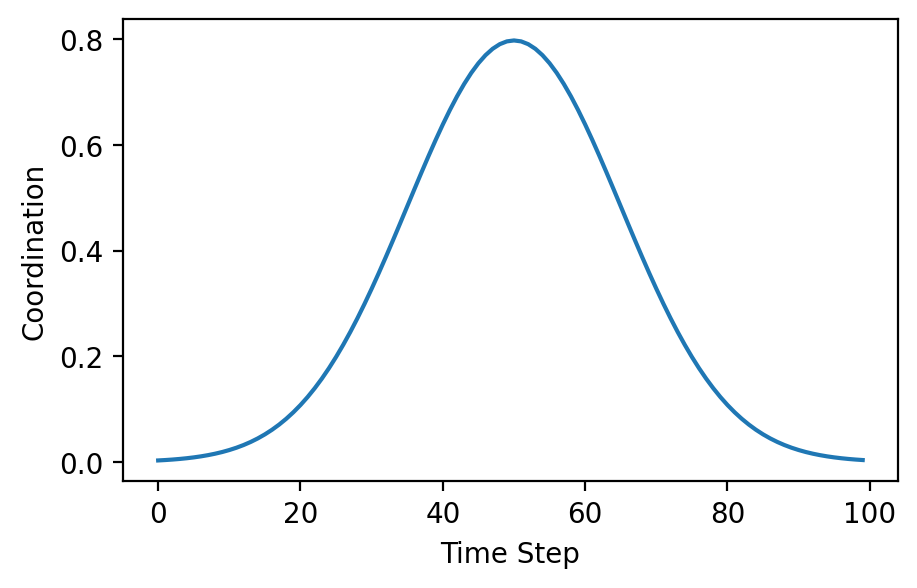

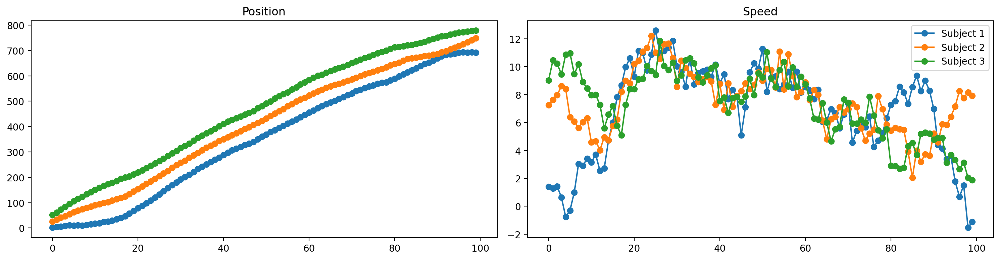

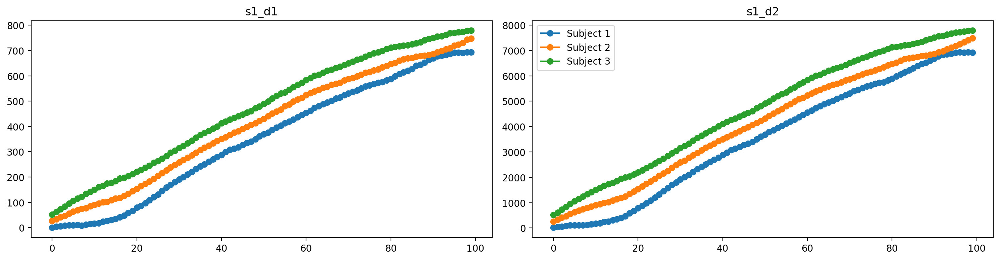

In [80]:
coordination = 30 * norm(loc=50, scale=15).pdf(np.arange(100))
template_bundle_d = configure_bundle(
    num_time_steps=100,
    coordination=coordination,
    noise=1
)

model = FNIRSModel(deepcopy(template_bundle_d))
data_d = model.draw_samples()
update_config_bundle_from_samples(template_bundle_d, data_d)

fig = plt.figure(figsize=(5,3))	
plt.plot(np.arange(100), coordination)
plt.xlabel("Time Step")
plt.ylabel("Coordination")
plot_state_space(data_d)
plot_observations(data_d)

### d1. No given parameters

Auto-assigning NUTS sampler...
INFO:pymc:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, neural_activity_mean_a0, neural_activity_sd_a, neural_activity, channels_sd_o]
INFO:pymc:NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, neural_activity_mean_a0, neural_activity_sd_a, neural_activity, channels_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 297 seconds.
INFO:pymc:Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 297 seconds.


                  variable converged  mean_rhat  std_rhat
0    coordination_mean_uc0       yes   1.004837  0.000000
1   unbounded_coordination       yes   1.008796  0.003512
2  neural_activity_mean_a0       yes   1.000209  0.000329
3          neural_activity       yes   1.000492  0.000482
4       coordination_sd_uc       yes   1.032289  0.000000
5     neural_activity_sd_a       yes   1.002527  0.000000
6            channels_sd_o       yes   1.001218  0.000000
7             coordination       yes   1.008121  0.003958


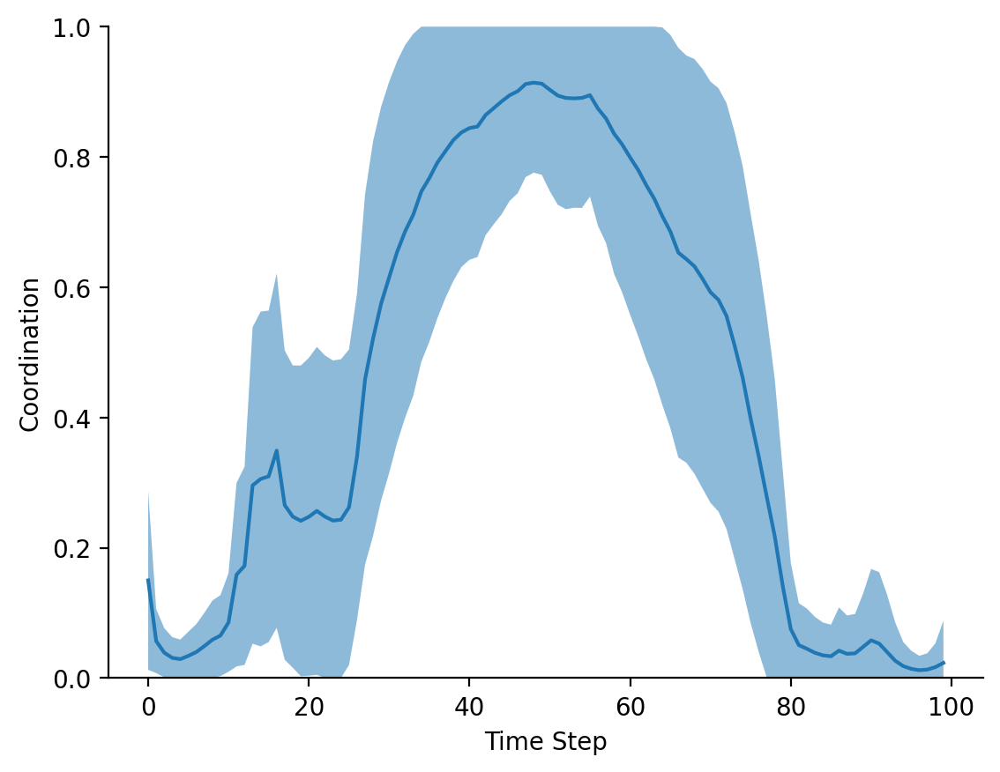

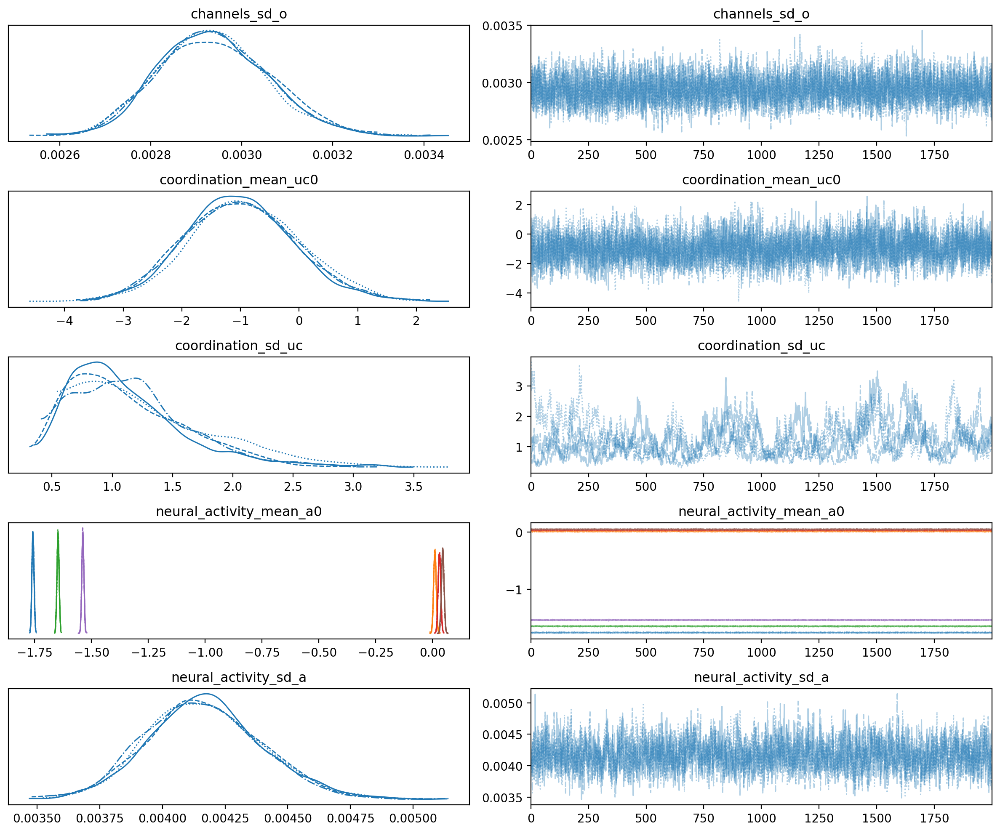

In [81]:
model = FNIRSModel(deepcopy(template_bundle_d))

model.config_bundle.sd_a = None
model.config_bundle.sd_o = None
model.config_bundle.mean_a0 = None
model.config_bundle.mean_uc0 = None
model.config_bundle.sd_uc = None
model.config_bundle.weights = [np.array([[1,1]])] # Important if normalization per feature is used

idata_d1 = train(model)

#### State space estimation

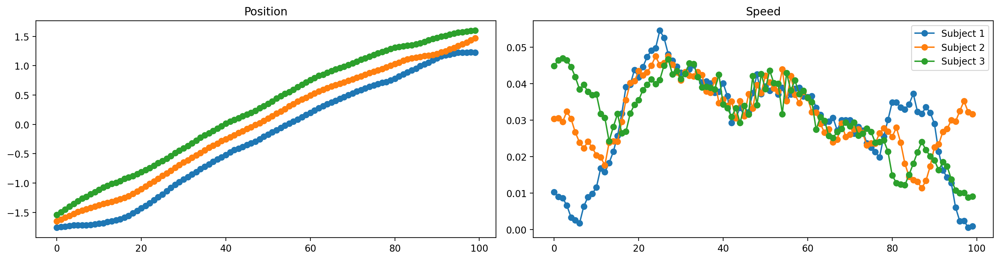

In [82]:
data_cp = deepcopy(data_d)
data_cp.component_group_samples["neural_activity"].values[0] = idata_d1.average_posterior_samples("neural_activity", return_std=False)
plot_state_space(data_cp)

### d2. Fixed sd_uc = 0.1

Auto-assigning NUTS sampler...
INFO:pymc:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, unbounded_coordination, neural_activity_mean_a0, neural_activity_sd_a, neural_activity, channels_sd_o]
INFO:pymc:NUTS: [coordination_mean_uc0, unbounded_coordination, neural_activity_mean_a0, neural_activity_sd_a, neural_activity, channels_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 323 seconds.
INFO:pymc:Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 323 seconds.


                  variable converged  mean_rhat  std_rhat
0    coordination_mean_uc0       yes   1.015018  0.000000
1   unbounded_coordination       yes   1.042696  0.012975
2  neural_activity_mean_a0       yes   1.000429  0.000541
3          neural_activity       yes   1.000411  0.000487
4     neural_activity_sd_a       yes   1.003504  0.000000
5            channels_sd_o       yes   1.001340  0.000000
6             coordination       yes   1.042696  0.012975


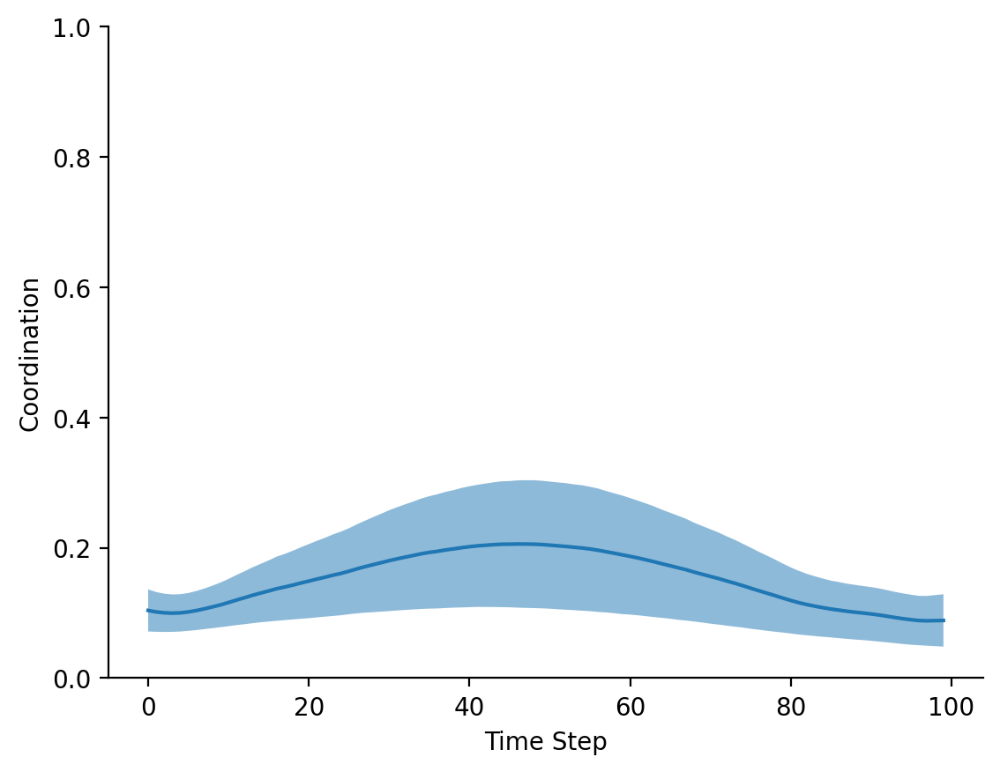

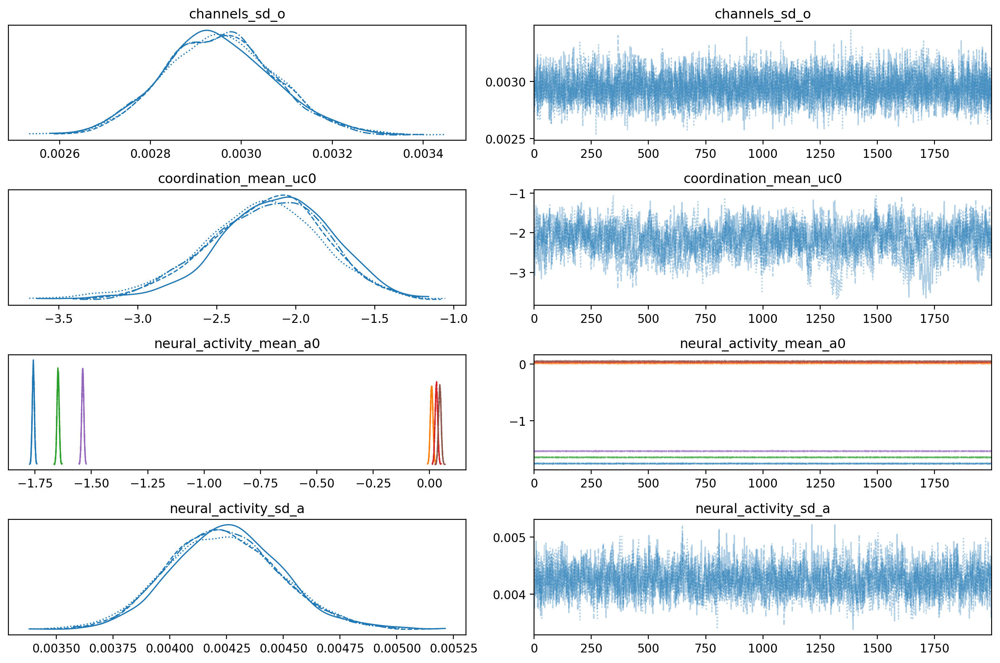

In [83]:
model = FNIRSModel(deepcopy(template_bundle_d))

model.config_bundle.sd_a = None
model.config_bundle.sd_o = None
model.config_bundle.mean_a0 = None
model.config_bundle.mean_uc0 = None
model.config_bundle.sd_uc = 0.1
model.config_bundle.weights = [np.array([[1,1]])] # Important if normalization per feature is used

idata_d2 = train(model)

#### State space estimation

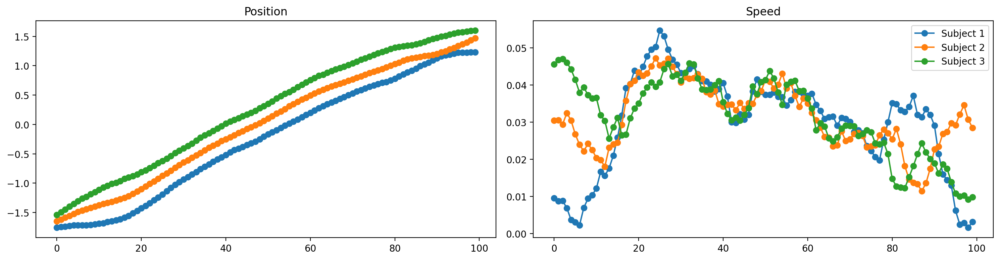

In [84]:
data_cp = deepcopy(data_d)
data_cp.component_group_samples["neural_activity"].values[0] = idata_d2.average_posterior_samples("neural_activity", return_std=False)
plot_state_space(data_cp)

# Data density

How the uncertainty increases when we don't have samples at every time step.

## e. 80%

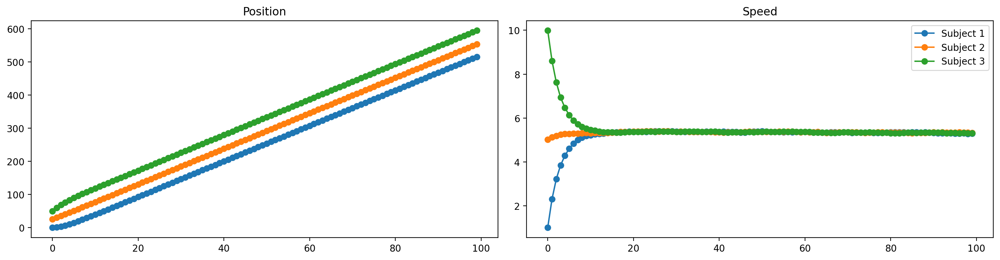

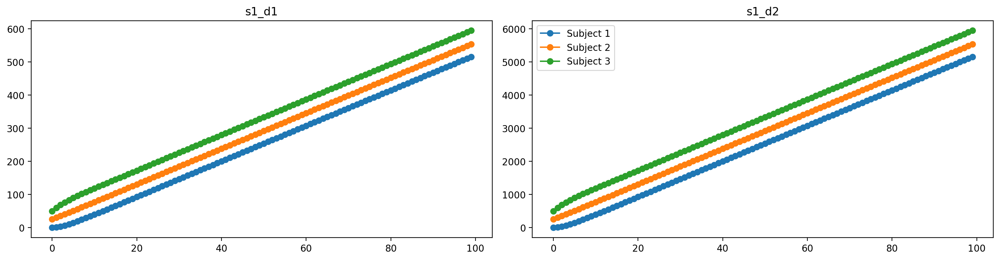

In [85]:
template_bundle_e = configure_bundle(
    num_time_steps=100,
    coordination=0.2,
    noise=0.01
)

template_bundle_e.sampling_time_scale_density = 0.8
model = FNIRSModel(deepcopy(template_bundle_e))
data_e = model.draw_samples()
update_config_bundle_from_samples(template_bundle_e, data_e)

plot_state_space(data_e)
plot_observations(data_e)

Auto-assigning NUTS sampler...
INFO:pymc:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, neural_activity_mean_a0, neural_activity_sd_a, neural_activity, channels_sd_o]
INFO:pymc:NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, neural_activity_mean_a0, neural_activity_sd_a, neural_activity, channels_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 1446 seconds.
INFO:pymc:Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 1446 seconds.


                  variable converged  mean_rhat  std_rhat
0    coordination_mean_uc0        no   1.170859  0.000000
1   unbounded_coordination        no   1.268143  0.103296
2  neural_activity_mean_a0       yes   1.001392  0.001550
3          neural_activity       yes   1.000571  0.001126
4       coordination_sd_uc        no   1.626731  0.000000
5     neural_activity_sd_a       yes   1.003345  0.000000
6            channels_sd_o       yes   1.000964  0.000000
7             coordination        no   1.269684  0.105219


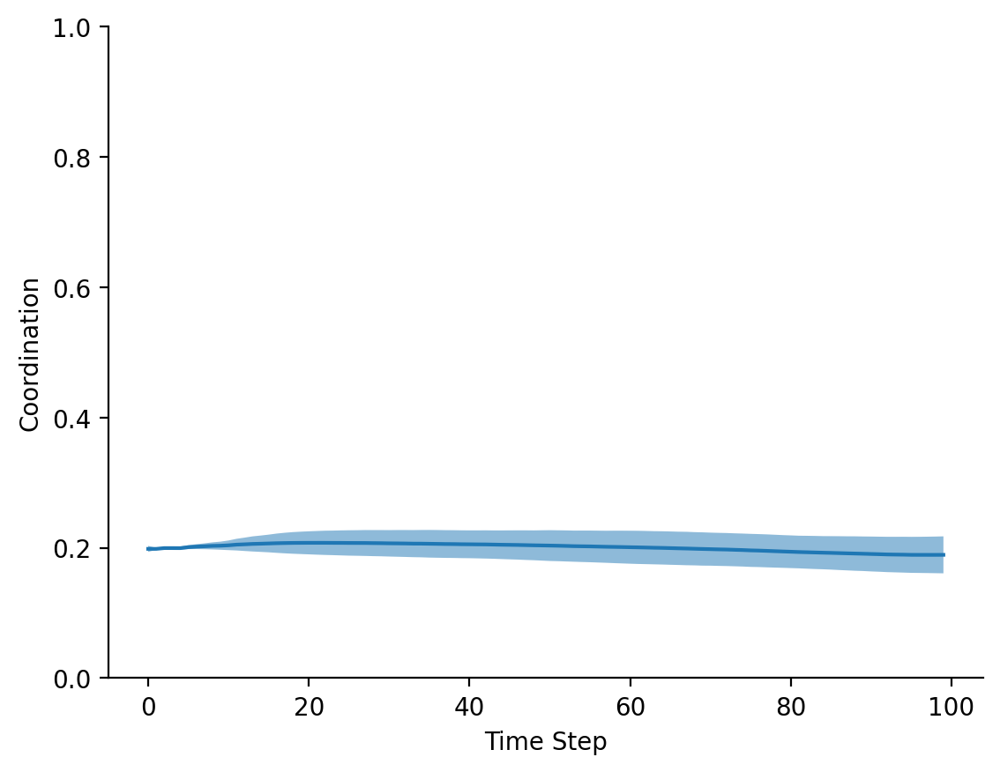

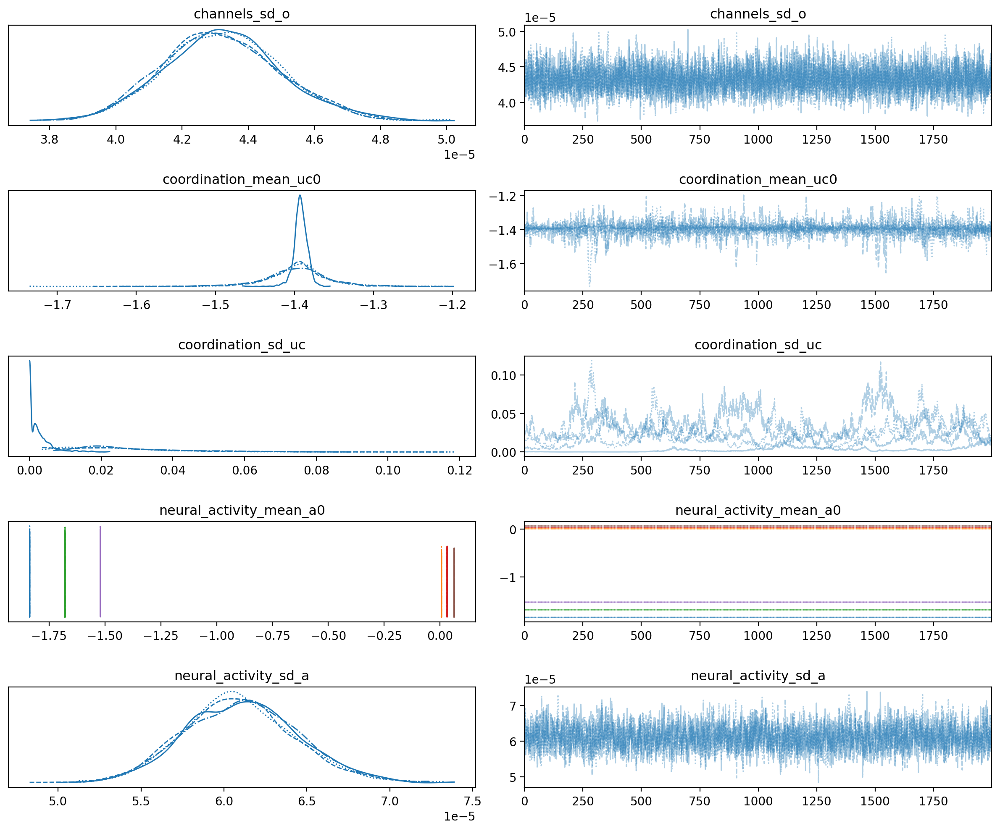

In [86]:
model = FNIRSModel(deepcopy(template_bundle_e))

model.config_bundle.sd_a = None
model.config_bundle.sd_o = None
model.config_bundle.mean_a0 = None
model.config_bundle.mean_uc0 = None
model.config_bundle.sd_uc = None
model.config_bundle.weights = [np.array([[1,1]])] # Important if normalization per feature is used

idata_e1 = train(model)

## f. 50%

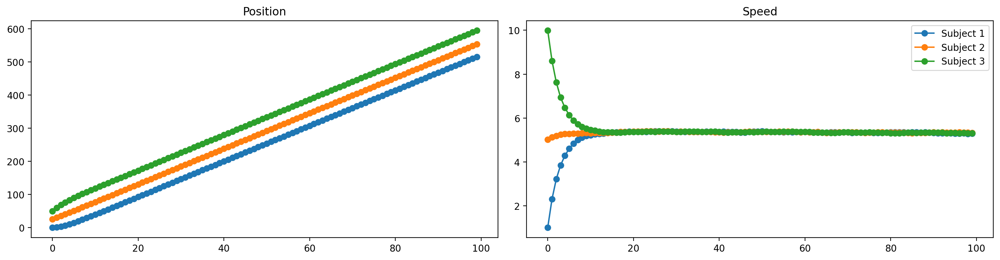

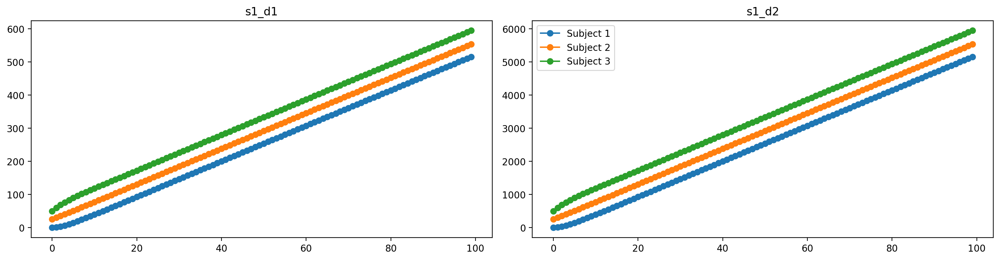

In [87]:
template_bundle_f = configure_bundle(
    num_time_steps=100,
    coordination=0.2,
    noise=0.01
)

template_bundle_f.sampling_time_scale_density = 0.5
model = FNIRSModel(deepcopy(template_bundle_f))
data_f = model.draw_samples()
update_config_bundle_from_samples(template_bundle_f, data_f)

plot_state_space(data_f)
plot_observations(data_f)

Auto-assigning NUTS sampler...
INFO:pymc:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, neural_activity_mean_a0, neural_activity_sd_a, neural_activity, channels_sd_o]
INFO:pymc:NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, neural_activity_mean_a0, neural_activity_sd_a, neural_activity, channels_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 1308 seconds.
INFO:pymc:Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 1308 seconds.


                  variable converged  mean_rhat  std_rhat
0    coordination_mean_uc0        no   1.170859  0.000000
1   unbounded_coordination        no   1.268143  0.103296
2  neural_activity_mean_a0       yes   1.001392  0.001550
3          neural_activity       yes   1.000571  0.001126
4       coordination_sd_uc        no   1.626731  0.000000
5     neural_activity_sd_a       yes   1.003345  0.000000
6            channels_sd_o       yes   1.000964  0.000000
7             coordination        no   1.269684  0.105219


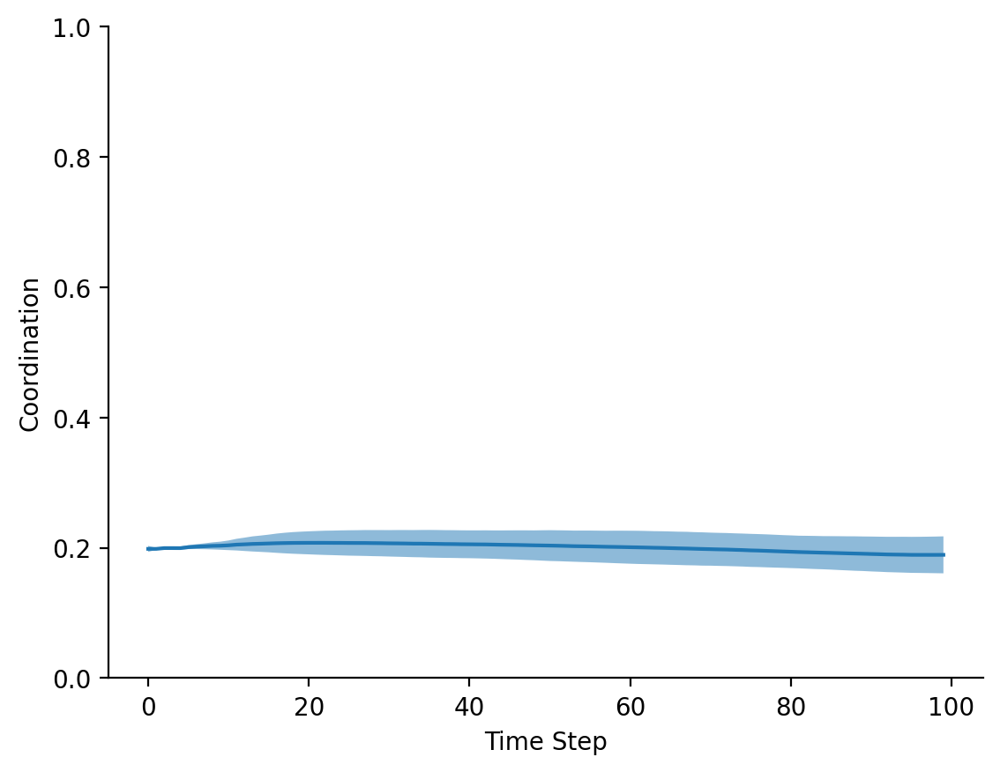

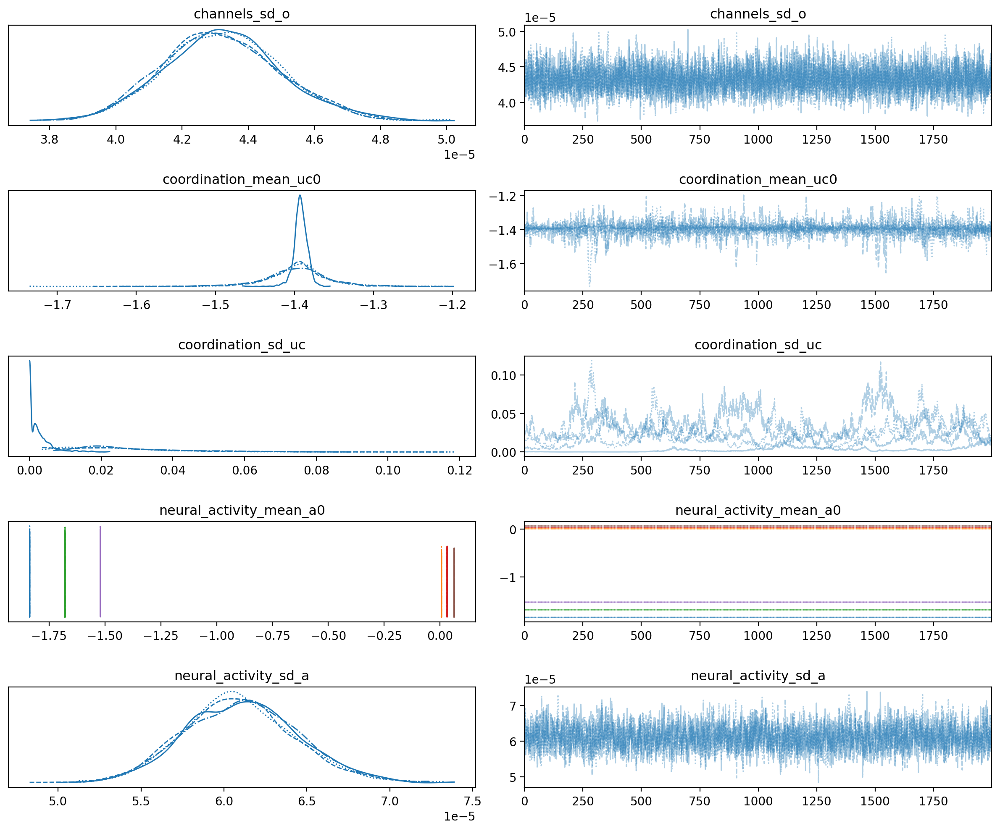

In [88]:
model = FNIRSModel(deepcopy(template_bundle_f))

model.config_bundle.sd_a = None
model.config_bundle.sd_o = None
model.config_bundle.mean_a0 = None
model.config_bundle.mean_uc0 = None
model.config_bundle.sd_uc = None
model.config_bundle.weights = [np.array([[1,1]])] # Important if normalization per feature is used

idata_f1 = train(model)

## g. 20%

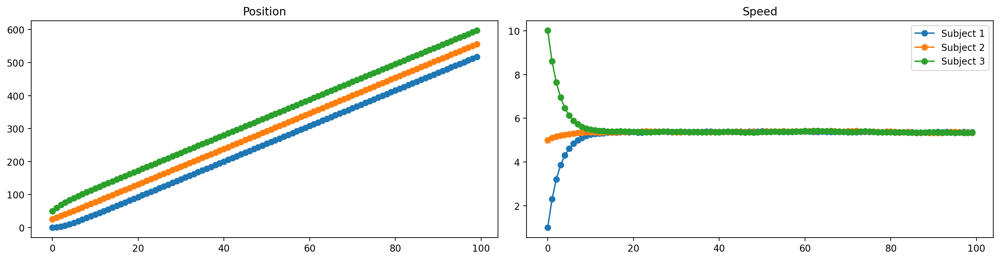

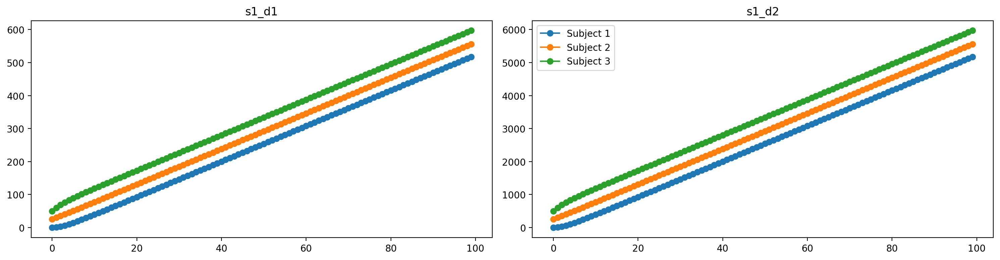

In [89]:
template_bundle_g = configure_bundle(
    num_time_steps=100,
    coordination=0.2,
    noise=0.01
)

template_bundle_g.sampling_time_scale_density = 0.2
model = FNIRSModel(deepcopy(template_bundle_g))
data_g = model.draw_samples(seed=5)
update_config_bundle_from_samples(template_bundle_g, data_g)

plot_state_space(data_g)
plot_observations(data_g)

Auto-assigning NUTS sampler...
INFO:pymc:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, neural_activity_mean_a0, neural_activity_sd_a, neural_activity, channels_sd_o]
INFO:pymc:NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, neural_activity_mean_a0, neural_activity_sd_a, neural_activity, channels_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 873 seconds.
INFO:pymc:Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 873 seconds.


                  variable converged  mean_rhat  std_rhat
0    coordination_mean_uc0        no   1.681990  0.000000
1   unbounded_coordination        no   1.770030  0.110370
2  neural_activity_mean_a0        no   1.279937  0.175184
3          neural_activity        no   1.307500  0.181749
4       coordination_sd_uc        no   1.717846  0.000000
5     neural_activity_sd_a        no   1.263993  0.000000
6            channels_sd_o       yes   1.069760  0.000000
7             coordination        no   1.772118  0.111767


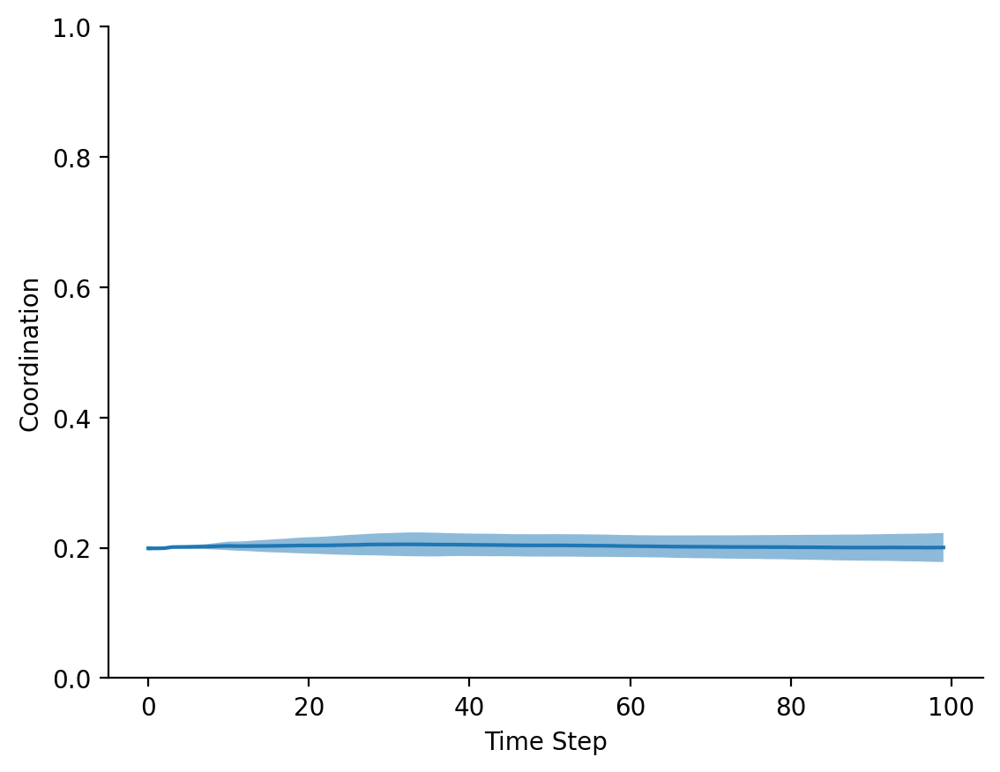

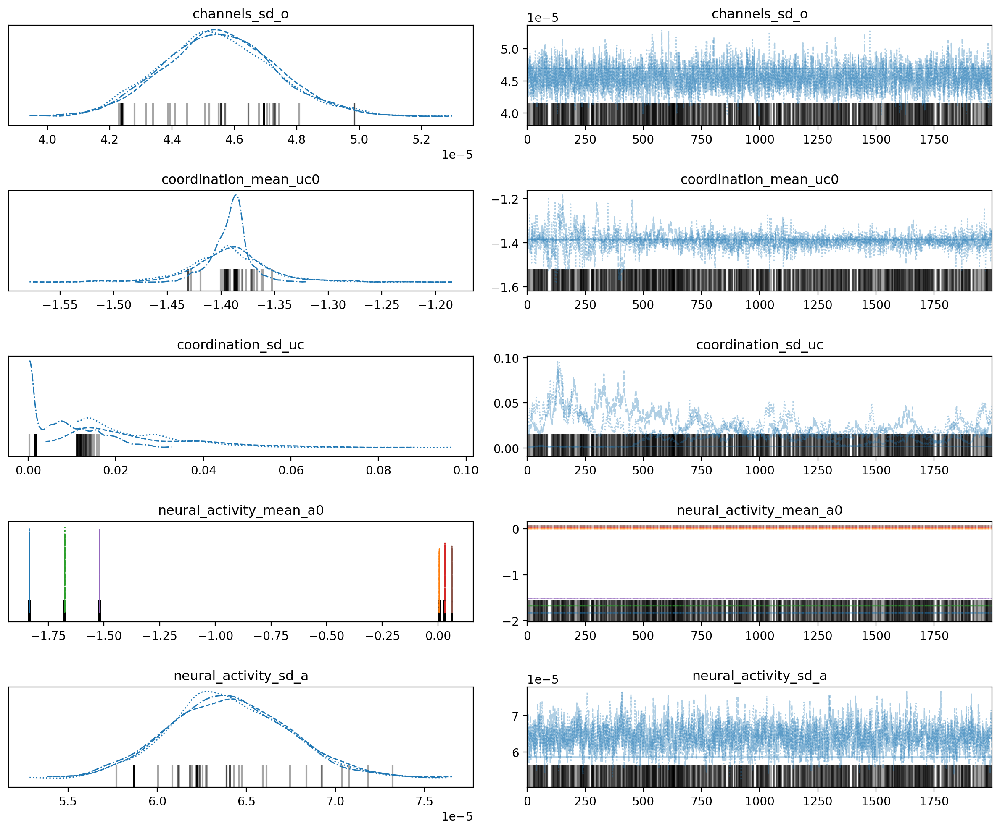

In [91]:
model = FNIRSModel(deepcopy(template_bundle_g))

model.config_bundle.sd_a = None
model.config_bundle.sd_o = None
model.config_bundle.mean_a0 = None
model.config_bundle.mean_uc0 = None
model.config_bundle.sd_uc = None
model.config_bundle.weights = [np.array([[1,1]])] # Important if normalization per feature is used

idata_g1 = train(model)

## h. 20% single peak coordination

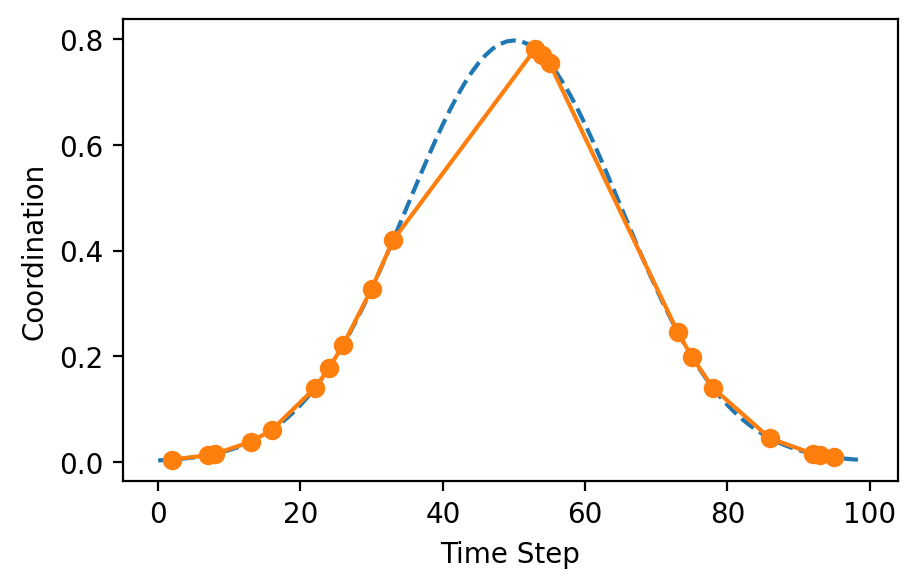

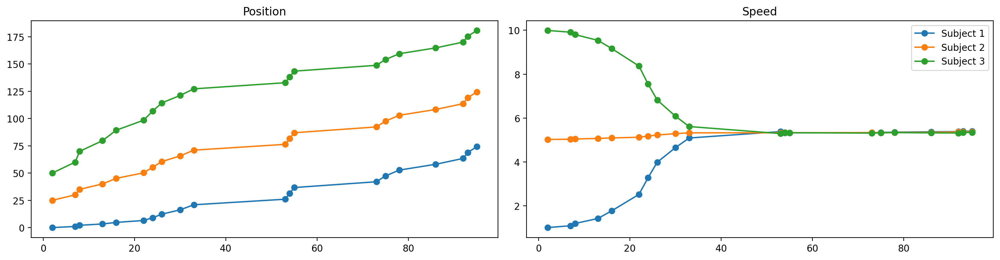

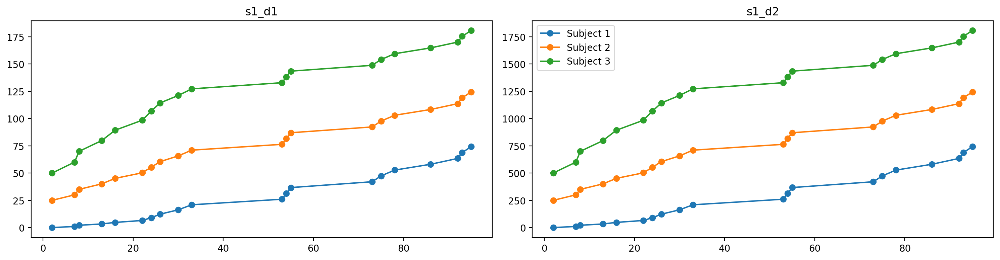

In [92]:
np.random.seed(0)
time_steps_to_keep = np.random.choice(np.arange(100), size=20, replace=False)
time_steps_to_keep.sort()
coordination = 30 * norm(loc=50, scale=15).pdf(np.arange(100))

template_bundle_h = configure_bundle(
    num_time_steps=20,
    coordination=coordination[time_steps_to_keep],
    noise=0.01
)

model = FNIRSModel(deepcopy(template_bundle_h))
data_h = model.draw_samples()

# Samples to keep
template_bundle_h.num_time_steps_in_coordination_scale = 100
data_h.component_group_samples["neural_activity"].time_steps_in_coordination_scale[0] = time_steps_to_keep
data_h.component_group_samples["channels"].time_steps_in_coordination_scale[0] = time_steps_to_keep
update_config_bundle_from_samples(template_bundle_h, data_h)

fig = plt.figure(figsize=(5,3))	
plt.plot(np.arange(100), coordination, "--")
plt.plot(time_steps_to_keep, coordination[time_steps_to_keep], marker="o")
plt.xlabel("Time Step")
plt.ylabel("Coordination")
plot_state_space(data_h)
plot_observations(data_h)

Auto-assigning NUTS sampler...
INFO:pymc:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, neural_activity_mean_a0, neural_activity_sd_a, neural_activity, channels_sd_o]
INFO:pymc:NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, neural_activity_mean_a0, neural_activity_sd_a, neural_activity, channels_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 432 seconds.
INFO:pymc:Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 432 seconds.


                  variable converged  mean_rhat  std_rhat
0    coordination_mean_uc0       yes   1.003313  0.000000
1   unbounded_coordination       yes   1.005713  0.005123
2  neural_activity_mean_a0       yes   1.000525  0.000565
3          neural_activity       yes   1.000564  0.000476
4       coordination_sd_uc       yes   1.008945  0.000000
5     neural_activity_sd_a       yes   1.005481  0.000000
6            channels_sd_o       yes   1.000559  0.000000
7             coordination       yes   1.005708  0.005128


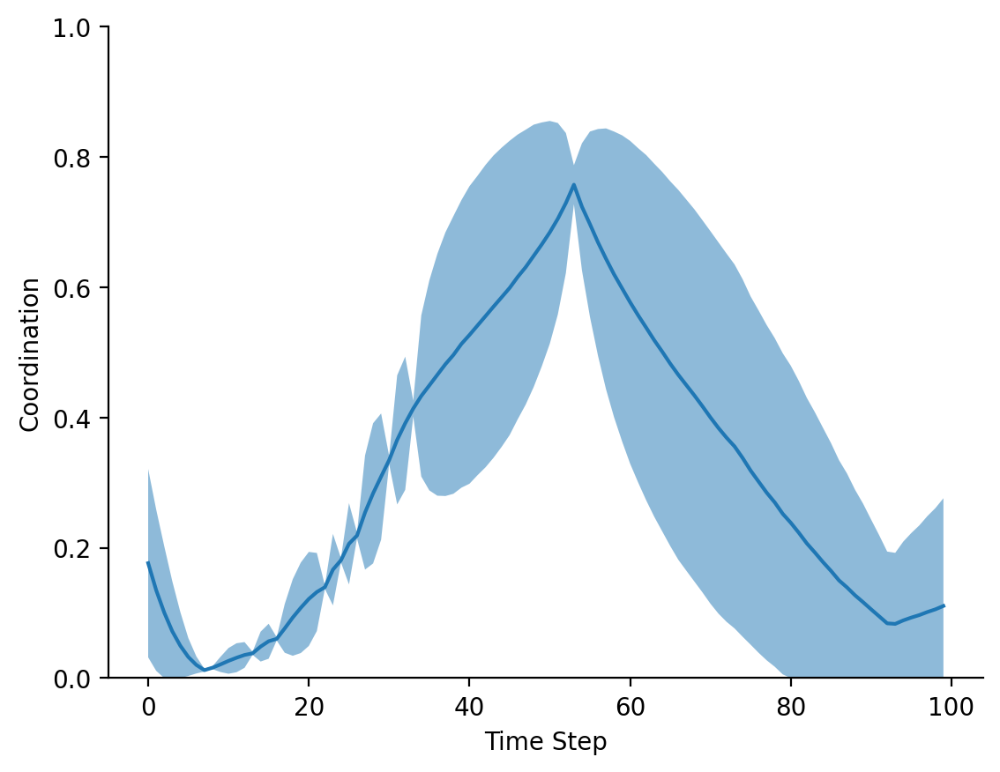

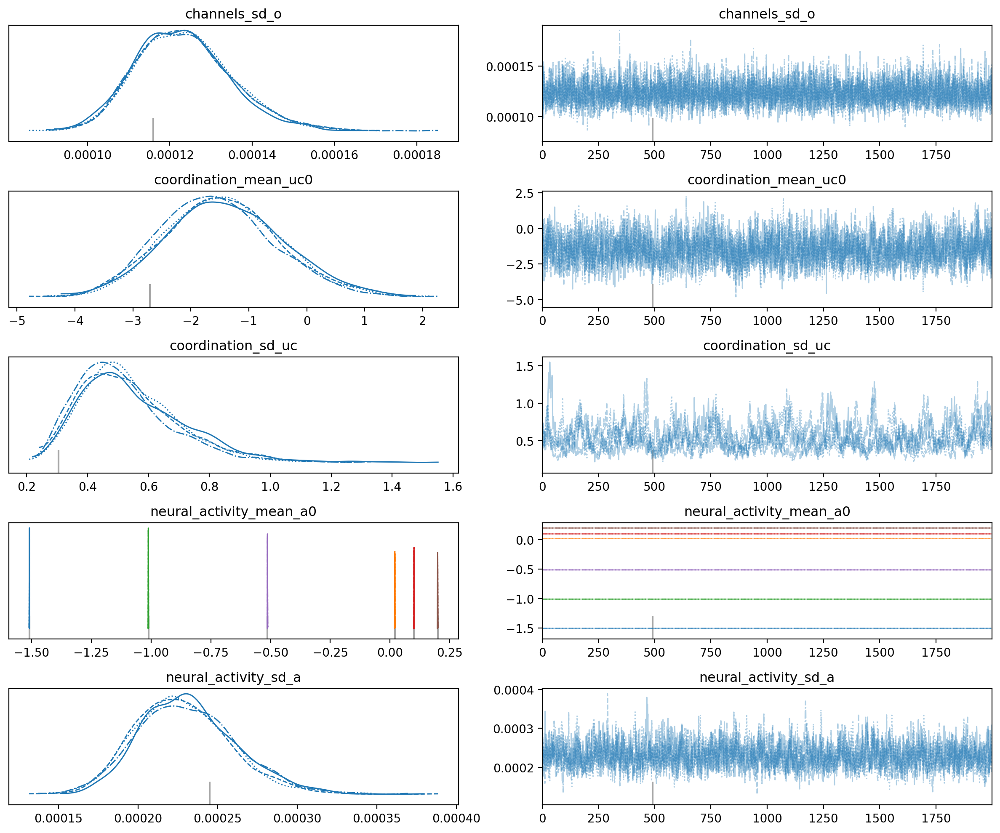

In [93]:
model = FNIRSModel(deepcopy(template_bundle_h))

model.config_bundle.sd_a = None
model.config_bundle.sd_o = None
model.config_bundle.mean_a0 = None
model.config_bundle.mean_uc0 = None
model.config_bundle.sd_uc = None
model.config_bundle.weights = [np.array([[1,1]])] # Important if normalization per feature is used

idata_h1 = train(model)

#### Longer burn-in

Auto-assigning NUTS sampler...
INFO:pymc:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, neural_activity_mean_a0, neural_activity_sd_a, neural_activity, channels_sd_o]
INFO:pymc:NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, neural_activity_mean_a0, neural_activity_sd_a, neural_activity, channels_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 4_000 tune and 2_000 draw iterations (16_000 + 8_000 draws total) took 567 seconds.
INFO:pymc:Sampling 4 chains for 4_000 tune and 2_000 draw iterations (16_000 + 8_000 draws total) took 567 seconds.


                  variable converged  mean_rhat  std_rhat
0    coordination_mean_uc0       yes   1.010096  0.000000
1   unbounded_coordination       yes   1.008376  0.007193
2  neural_activity_mean_a0       yes   1.000708  0.000611
3          neural_activity       yes   1.000523  0.000535
4       coordination_sd_uc       yes   1.027883  0.000000
5     neural_activity_sd_a       yes   1.001407  0.000000
6            channels_sd_o       yes   1.000553  0.000000
7             coordination       yes   1.008291  0.007255


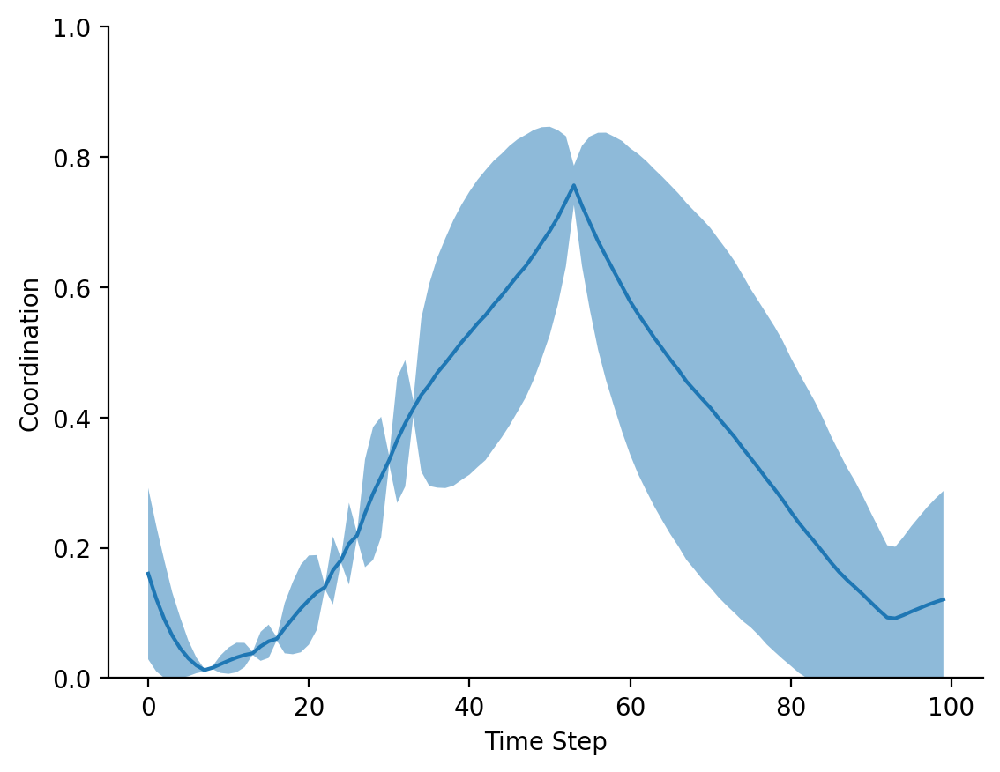

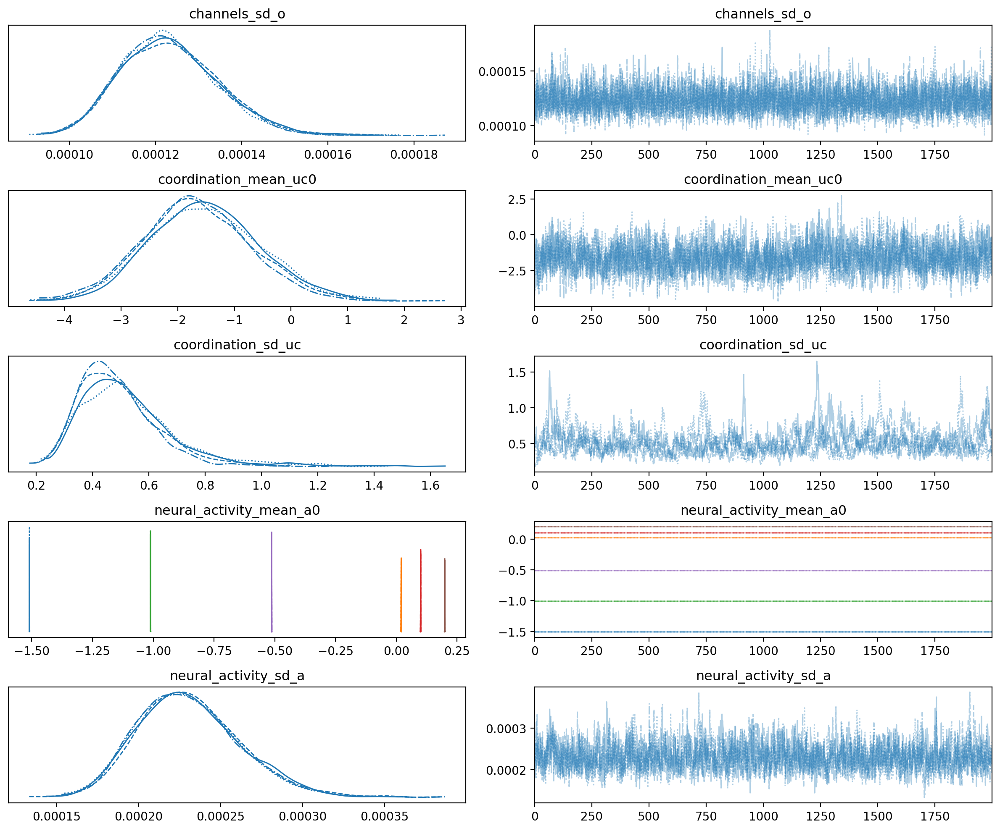

In [94]:
idata_h2 = train(model, burn_in=4000, recreate_variables=False)

Auto-assigning NUTS sampler...
INFO:pymc:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, neural_activity_mean_a0, neural_activity_sd_a, neural_activity, channels_sd_o]
INFO:pymc:NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, neural_activity_mean_a0, neural_activity_sd_a, neural_activity, channels_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 426 seconds.
INFO:pymc:Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 426 seconds.


                  variable converged  mean_rhat  std_rhat
0    coordination_mean_uc0       yes   1.004844  0.000000
1   unbounded_coordination       yes   1.004708  0.003693
2  neural_activity_mean_a0       yes   1.000705  0.000510
3          neural_activity       yes   1.000531  0.000521
4       coordination_sd_uc       yes   1.013050  0.000000
5     neural_activity_sd_a       yes   1.002508  0.000000
6            channels_sd_o       yes   1.001129  0.000000
7             coordination       yes   1.004587  0.003737


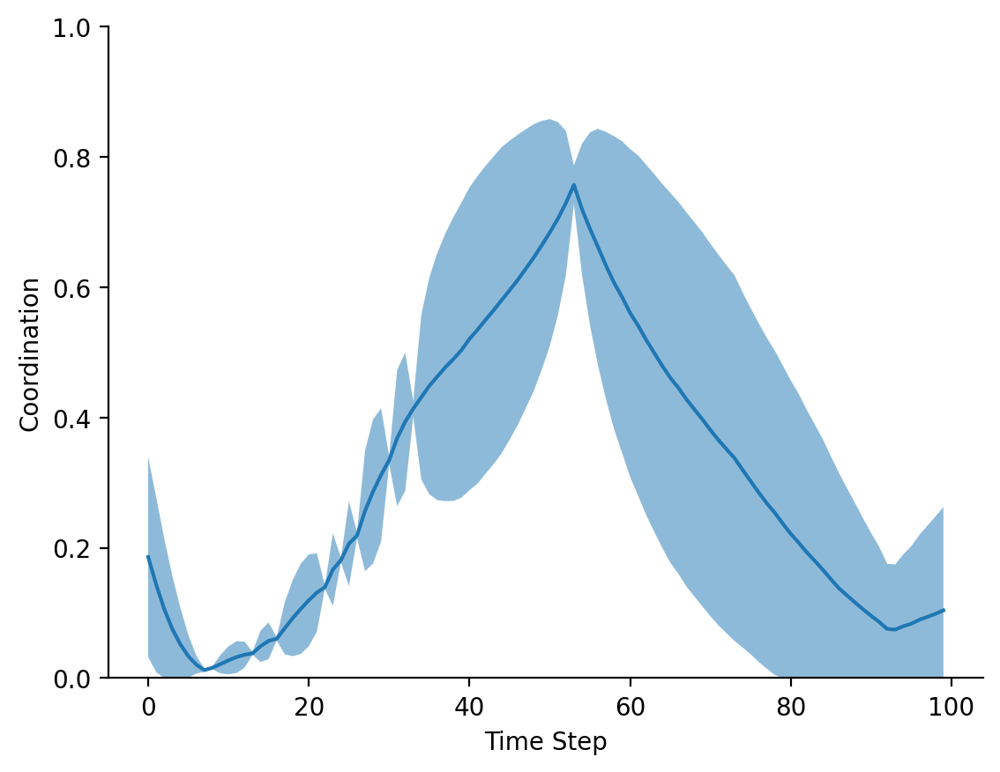

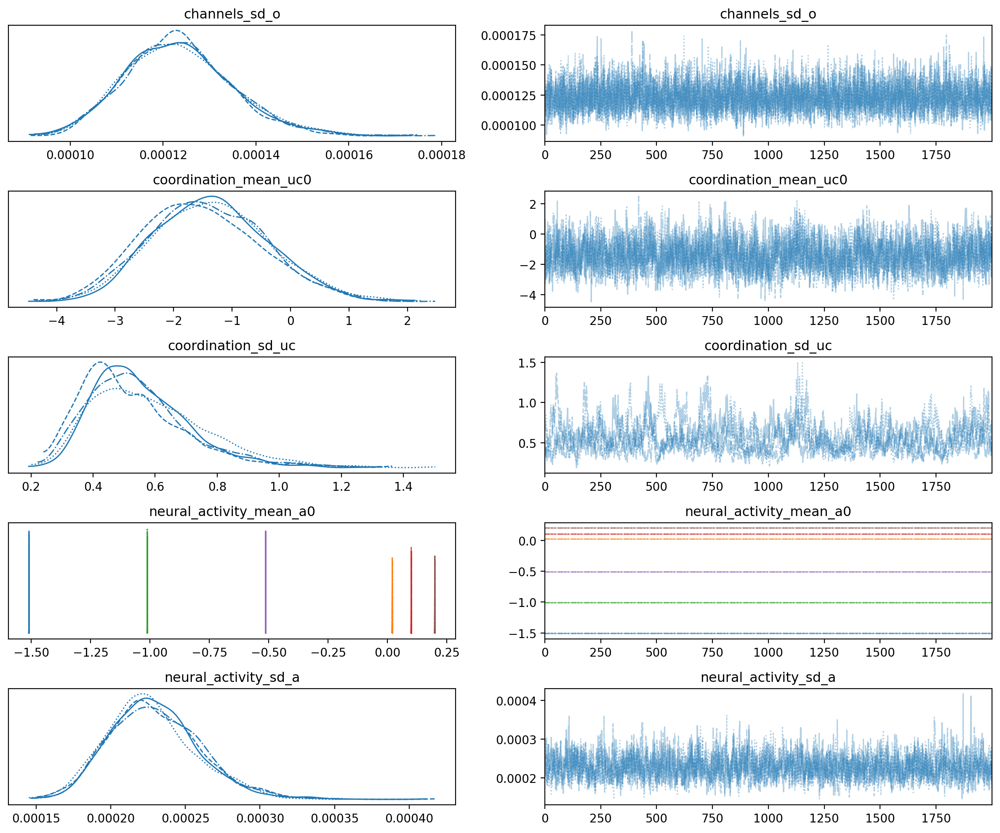

In [95]:
model = FNIRSModel(deepcopy(template_bundle_h))

model.config_bundle.sd_a = None
model.config_bundle.sd_o = None
model.config_bundle.mean_a0 = None
model.config_bundle.mean_uc0 = None
model.config_bundle.sd_uc = None
model.config_bundle.sd_sd_uc = 5
model.config_bundle.weights = [np.array([[1,1]])] # Important if normalization per feature is used

idata_h3 = train(model)

# Convergence

Assess whether increasing the number of burn-in samples leads to better convergence.

## i. replicating a4 larger burn-in samples

In [96]:
model = FNIRSModel(deepcopy(template_bundle_a))

model.config_bundle.sd_a = None
model.config_bundle.sd_o = None
model.config_bundle.mean_a0 = None
model.config_bundle.mean_uc0 = None
model.config_bundle.sd_uc = None
model.config_bundle.weights = [np.array([[1,1]])] # Important if normalization per feature is used

### i1. burn-in = 8000

Auto-assigning NUTS sampler...
INFO:pymc:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, neural_activity_mean_a0, neural_activity_sd_a, neural_activity, channels_sd_o]
INFO:pymc:NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, neural_activity_mean_a0, neural_activity_sd_a, neural_activity, channels_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 8_000 tune and 2_000 draw iterations (32_000 + 8_000 draws total) took 2314 seconds.
INFO:pymc:Sampling 4 chains for 8_000 tune and 2_000 draw iterations (32_000 + 8_000 draws total) took 2314 seconds.


                  variable converged  mean_rhat  std_rhat
0    coordination_mean_uc0        no   1.115301  0.000000
1   unbounded_coordination        no   1.252318  0.069681
2  neural_activity_mean_a0       yes   1.002114  0.002561
3          neural_activity       yes   1.001372  0.001230
4       coordination_sd_uc        no   1.532495  0.000000
5     neural_activity_sd_a       yes   1.003624  0.000000
6            channels_sd_o       yes   1.000307  0.000000
7             coordination        no   1.253039  0.069887


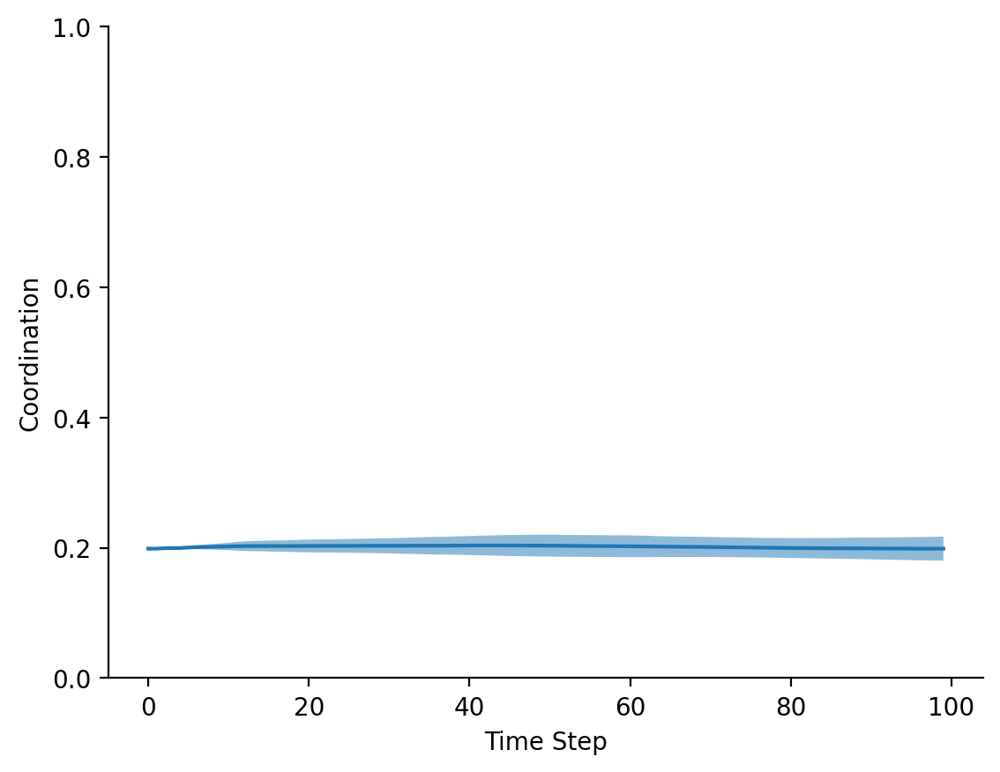

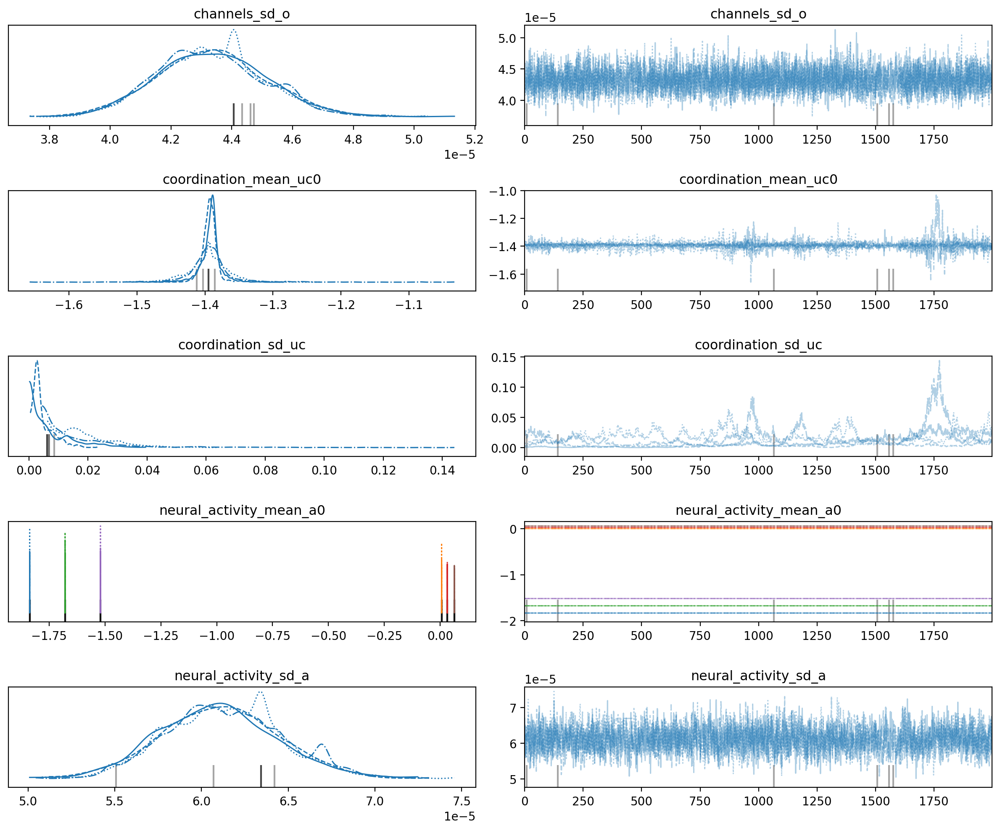

In [97]:
idata_i1 = train(model, burn_in=8000)

### i2. burn-in = 16000

Auto-assigning NUTS sampler...
INFO:pymc:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
INFO:pymc:Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, neural_activity_mean_a0, neural_activity_sd_a, neural_activity, channels_sd_o]
INFO:pymc:NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, neural_activity_mean_a0, neural_activity_sd_a, neural_activity, channels_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 16_000 tune and 2_000 draw iterations (64_000 + 8_000 draws total) took 3933 seconds.
INFO:pymc:Sampling 4 chains for 16_000 tune and 2_000 draw iterations (64_000 + 8_000 draws total) took 3933 seconds.


                  variable converged  mean_rhat  std_rhat
0    coordination_mean_uc0        no   1.698071  0.000000
1   unbounded_coordination        no   1.461289  0.203064
2  neural_activity_mean_a0        no   1.316403  0.174949
3          neural_activity        no   1.300816  0.181173
4       coordination_sd_uc        no   1.862301  0.000000
5     neural_activity_sd_a        no   1.106782  0.000000
6            channels_sd_o        no   1.524479  0.000000
7             coordination        no   1.460640  0.201569


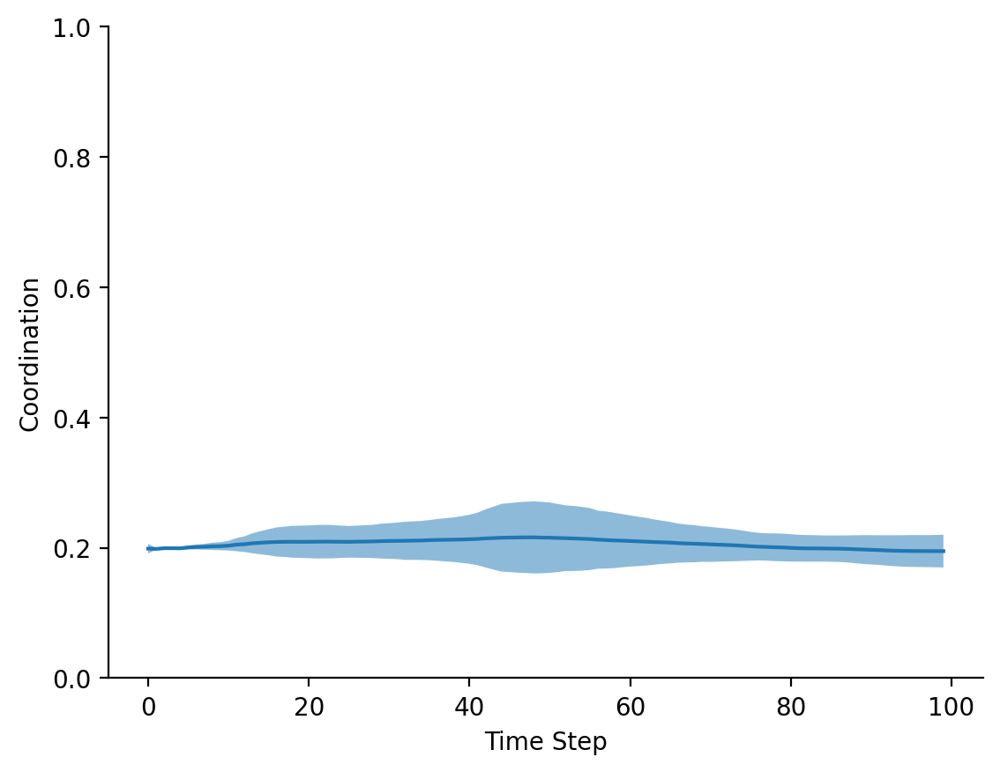

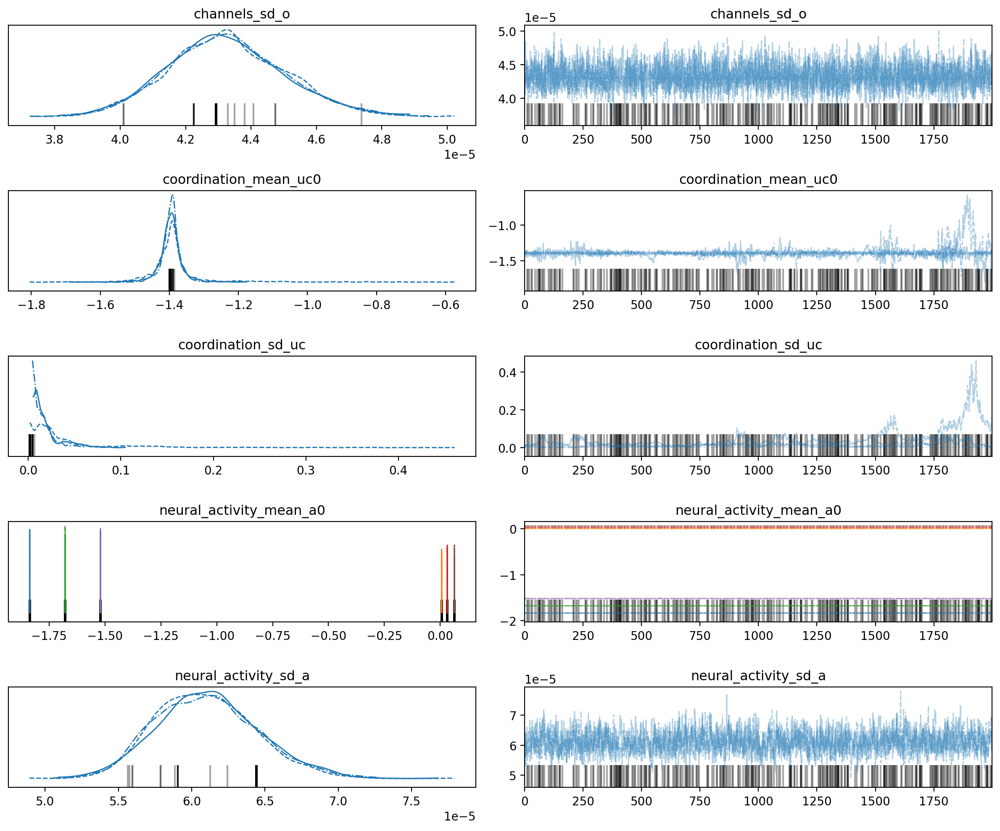

In [98]:
idata_i2 = train(model, burn_in=16000, recreate_variables=False)